In [ ]:
import torch
from torch import nn
from torch.nn import functional as F
from torch.utils.data import Dataset
import torchvision
from torchvision import datasets, transforms
from torch.utils.data import IterableDataset
import matplotlib.pyplot as plt
import numpy as np
import PIL
import tensorboard
from torch.utils.tensorboard import SummaryWriter
%load_ext tensorboard
import tensorflow
import math
import datetime

# check GPU is enabled
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Select the Runtime > "Change runtime type" menu to enable a GPU accelerator, ')
  print('and then re-execute this cell.')
else:
  print(gpu_info)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)



Tue May  9 13:34:45 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA A100-SXM...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   32C    P0    43W / 400W |      0MiB / 40960MiB |      0%      Default |
|                               |                      |             Disabled |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:

from google.colab import drive
drive.mount('/content/drive')

import glob
import cv2
import numpy as np
from sklearn.model_selection import train_test_split

PATH=r"/content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/"

class CT_Dataset(Dataset):
    def __init__(self):
        self.imgs_path = PATH+"challenge_data/"
        file_list = glob.glob(self.imgs_path + "*")
        print(file_list)
        self.data = []
        #num_folders=20
        
        for class_path in file_list:
            class_name = class_path.split("/")[-1]
            f=0 #counter for number of images so far
            for img_path in glob.glob(class_path + "/*.png"):
                self.data.append([img_path, 'true_CT'])
                f+=1
                #if f==990: break #make sure number of images is divisble by 5
            #print(f"folder {class_name}, num images {f}, {img_path}")
            #if f == 960: break
        print(f, len(self.data))
        self.class_map = {"fake_CT" : 0, "true_CT": 1}
        self.img_dim = (512, 512)
    def __len__(self):
        return len(self.data)
    def __getitem__(self, idx):
        img_path, class_name = self.data[idx]
        img = cv2.imread(img_path)
        #print(f"img loaded {img.size}")
        if img is None: #img.size !=786432):
          print('bad file', img_path)
          return self.__getitem__(idx+1)   
        #img = cv2.resize(img, self.img_dim)
        class_id = self.class_map[class_name]
        img_tensor=torch.as_tensor(img/255.,dtype=torch.float)
        img_tensor = img_tensor.permute(2, 0, 1)
        #rescale images from [0,1] to [-1,1] scale
        #img_tensor = (img_tensor-0.5)/0.5
        class_id = torch.tensor([class_id])
        return img_tensor, class_id

trainset=CT_Dataset()


Define torch data loaders

In [ ]:
batch_size = 5 #number of images to load in each training iteration (maybe increase to 64?)
train_dataloader = torch.utils.data.DataLoader(trainset, batch_size=batch_size, 
                                               shuffle=True, num_workers=2)


Visualize an example of training data (just for reference)

In [ ]:
from matplotlib.transforms import Transform
images, labels = next(iter(train_dataloader))
print(images.shape, images.type())
#print(len(train_dataloader))
#print(images[0].permute(1,2,0).shape)
plt.imshow(images[0].permute(1,2,0))

print(f"max pixel {torch.max(images[0])}, min pixel {torch.min(images[0])}")
print(f"mean pixels {torch.mean(images[0], dim=(2,1))}, std dev {torch.std(images[0],dim=(2,1))}")

figure = plt.figure(figsize=(20, 20))
cols, rows = 5, 1
for i in range(5):  
    figure.add_subplot(rows,cols, i+1)
    plt.axis("off")
    img=images[i].permute(1,2,0)
    plt.imshow(img) 
plt.show()


Define neural net model classes


In [ ]:
#ngpu = device (1=gpu, 0=cpu)
#nz = length of length of input vector
#ngf/ndf=feature map size
#nc=number of channels (1 for black and white)

if device=='cpu':
  ngpu=0
else:
  ngpu=1
ngf=512
ndf=512 #128 #512
nc=3
nz=100

#for conv2d input torch format is [batch_size, channels, height, width] ie [64,3,512,512]
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf*8, 4, 1, 0, bias=False), #(in_channels=100,out_channels=4096, kernal size (4, 4), stride(1,1), padding=0)
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4=4096x4x4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 4, 0, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            #state size (ngf*4)x2048x8x8
            nn.ConvTranspose2d( ngf*4, ngf * 2, 4, 4, 0, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16=1024 x 16 x16    
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 4, 0, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32 = 512 x 32 x32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            #nn.LeakyReLU(0.2, inplace=True),  #adding an extra relu layer here effectively clips output to [0.1], without this outputs are [-1,1]
            nn.Tanh(),
            #TRY ADDING A ReLU layer here!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
            nn.ReLU(False)
            # state size. (nc) x 64 x 64= 3 x 64 x64

        )

    def forward(self, input):
        #print(input.type)
        return self.main(input)

class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 4, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf *4, 4, 4, 1, bias=False),
            nn.BatchNorm2d(ndf *4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 4, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        #print(input.type)
        return self.main(input)



Option 1: Initialize net model with STARTING WEIGHTS (then train the model)

In [ ]:
generator= Generator(ngpu)
generator = generator.to(device)
#print(generator)

discriminator = Discriminator(ngpu)
discriminator = discriminator.to(device)
#print(discriminator)

def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)  #1.0 instead of 0
        nn.init.constant_(m.bias.data, 0.0)

weights_init(generator)
weights_init(discriminator)

Option 2:Initialize model by loading weights from previous training

In [ ]:
#initialize weights based on saved training weights

generator= Generator(ngpu)
generator = generator.to(device)

discriminator = Discriminator(ngpu)
discriminator = discriminator.to(device)

PATH = "/content/drive/MyDrive/Marquette Grad School/ct_gan_weights_best_long_2.pth" 
trained_weights=torch.load(PATH,map_location=torch.device(device))
generator.load_state_dict(trained_weights['generator_dict'])
discriminator.load_state_dict(trained_weights['discriminator_dict'])

<All keys matched successfully>

In [ ]:
summary(discriminator, (3,512,512))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1        [-1, 512, 256, 256]          24,576
         LeakyReLU-2        [-1, 512, 256, 256]               0
            Conv2d-3         [-1, 1024, 64, 64]       8,388,608
       BatchNorm2d-4         [-1, 1024, 64, 64]           2,048
         LeakyReLU-5         [-1, 1024, 64, 64]               0
            Conv2d-6         [-1, 2048, 16, 16]      33,554,432
       BatchNorm2d-7         [-1, 2048, 16, 16]           4,096
         LeakyReLU-8         [-1, 2048, 16, 16]               0
            Conv2d-9           [-1, 4096, 4, 4]     134,217,728
      BatchNorm2d-10           [-1, 4096, 4, 4]           8,192
        LeakyReLU-11           [-1, 4096, 4, 4]               0
           Conv2d-12              [-1, 1, 1, 1]          65,536
          Sigmoid-13              [-1, 1, 1, 1]               0
Total params: 176,265,216
Trainable par

Define training and testing functions

In [ ]:
from numpy.core.numeric import zeros_like
clamp_lower=-0.01
clamp_upper=0.01

def plot_losses(d_losses, g_losses,p_type):
  iters = [d[0] for d in d_losses]
  disc_vals =[d[1].detach().cpu().numpy() for d in d_losses]
  gen_vals = [g[1].detach().cpu().numpy() for g in g_losses]

  if p_type=='all':

    plt.figure
    plt.plot(iters,disc_vals, c='tab:blue', label='discriminator')
    plt.legend()
    plt.ylabel('BCE Loss')
    plt.xlabel('training iteration')
    plt.show()

    plt.figure
    plt.plot(iters,gen_vals,c='tab:orange', linestyle=(0,(5,10)),label='generator')
    plt.legend()
    plt.ylabel('BCE Loss')
    plt.xlabel('training iteration')
    plt.show()

  plt.figure
  plt.plot(iters,disc_vals,label='discriminator')
  plt.plot(iters,gen_vals,linestyle=(0,(5,10)),label='generator')
  plt.legend()
  plt.ylabel('BCE Loss')
  plt.xlabel('training iteration')
  plt.show()


def fake_data_batch(nz,batch_size):
  #generate random numbers in U[0,1]
  noise_signal = torch.randn(nz * batch_size,dtype=torch.float32)
	#reshape into a batch of grayscale images
  noise_signal=noise_signal.reshape((batch_size, nz,1, 1))
  #noise_signal.requires_grad=False
  # 'fake' class labels - 0s

  labels = torch.full((batch_size,1),0, dtype=torch.float32) #torch.zeros((batch_size, 1))
 
  return (noise_signal,labels) #f_dataloader


def train(dataloader, generator, discriminator, loss_fn, device):

    data_size = len(dataloader.dataset) #tensor (batch_size, 28, 28,1)
   
    #define optimizers
    generator_opt=torch.optim.Adam(generator.parameters(), lr=0.001, betas=(0.8,0.999))
    discriminator_opt=torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.2,0.999)) 
    training_steps=1000 #(was 500)
    num_epochs=10 #(was 10)
    
    discriminator_training_loss=[]
    generator_training_loss=[]
    images_during_training=[]
    early_batch=zeros_like
    iter_count=0

    dataloader_size=len(train_dataloader)
    print(dataloader_size)
    for epoch in range(num_epochs):
    #remaining_epochs=[6, 7, 8, 9]
    #for epoch in remaining_epochs:
      alpha = math.ceil(.6*(2**(10-epoch))) #how many times to repeat noise vector
      if epoch == 8: 
        #alpha = 1
        generator_opt.param_groups[0]['lr'] = 0.0005
        #discriminator_opt.param_groups[0]['lr'] = 0.0002
      print('epoch:',epoch, 'repeat: ', alpha, '------------------------------')
      for i in range(min(training_steps*alpha,2500)):
        #clamp_penalty=0
        #get some real images from the dataset (on 1st epoch, only load new data every 5 passes)
        real_images, labels = next(iter(train_dataloader))
        
        #dataloader_size -=1
        #print(dataloader_size)
        real_labels=torch.ones([batch_size,1])
        real_labels=real_labels.type(torch.float).to(device)
        real_images.to(device)
        early_batch=zeros_like(real_images)
        
        #how well does discriminator do on real images?
        discriminator_opt.zero_grad()
        
        real_discriminator=torch.reshape(discriminator(real_images.to(device)).squeeze(), [batch_size,1])
        #print(f"real_discriminator shape {real_discriminator.shape}")
        real_Dloss = loss_fn(real_discriminator.to(device),real_labels)
        #print('real disc loss', real_Dloss.item())
        
        #backpropogate discriminator
        real_Dloss.backward()

         #use a new noise input batch for for each 20 iterations
         #new noise for every iteration didn't converge
        if i % (alpha) == 0:
          noise_images, fake_labels = fake_data_batch(nz, batch_size)
        #fake_labels.to(device)
        #use fake images to train the generator network
        generated_images = generator(noise_images.to(device))
        
        #how well does discriminator do on fake images?
        #noisy generated images
        noise_add=torch.randn_like(generated_images)*.005
        fake_discriminator=discriminator(generated_images.detach()+noise_add).to(device)
        fake_discriminator=torch.reshape(fake_discriminator.squeeze(),[batch_size,1])
        fake_Dloss=loss_fn(fake_discriminator.to(device), fake_labels.to(device))
       
        #backpropogate
        fake_Dloss.backward()

        #find the sum of the real and fake discriminator errors and use it to 
        #update the discriminator network
        D_loss=real_Dloss+fake_Dloss #+ -0.1*torch.min(generated_images)
        for p in discriminator.parameters():
            #if torch.min(p.data) <=-0.01:
              #print('discrim param clamp lower', torch.min(p.data), torch.max(p.data))
            #if torch.max(p.data)>=0.01:
              #print('discrim param clamp upper', torch.min(p.data), torch.max(p.data))
            p.data.clamp_(clamp_lower, clamp_upper)

        
        discriminator_opt.step()
        
        #zero gradients on each iteration
        generator_opt.zero_grad()
        
        #since we have now updated D, do another forward pass on the fake images
        noise_add=torch.randn_like(generated_images)*.005
        fake_discriminator2=discriminator(generated_images+noise_add) #try permute(1,2,0)?????
        fake_discriminator2=torch.reshape(fake_discriminator2.squeeze(),[batch_size,1])
        
        #use the output of this second pass on D, to find the error in G
        G_loss=loss_fn(fake_discriminator2,real_labels) #+ -10*torch.min(generated_images)

        #backpropogate generator
        G_loss.backward()
        for p in generator.parameters():
            if epoch < 3:
              p.data.clamp_(-0.5, 1.5) #SWITCH BACK TO 1.5????
            else:
              p.data.clamp_(-0.6, 1.5)
        
        generator_opt.step()

        discriminator_training_loss.append((iter_count,D_loss))
        generator_training_loss.append((iter_count,G_loss))
        iter_count+=1
      
        #Print current loss
        if i % 50 == 0:
          PATH = "/content/drive/MyDrive/Marquette Grad School/ct_gan_weights_best_retrain.pth" 
          if i % 200 == 0:
            torch.save({'discriminator_dict':discriminator.state_dict(), 'generator_dict':generator.state_dict()}, PATH)
            print(f"weights saved")
          if i % 500 == 0:
            plot_losses(discriminator_training_loss, generator_training_loss, 'combo')
          
          loss_d, loss_g = D_loss.item(), G_loss.item()
          print(f"i={i}, loss: {loss_d:>7f}  {loss_g:>7f}")
          figure = plt.figure(figsize=(6, 6))
          cols, rows = 5, 1
          for i in range(5):  
            figure.add_subplot(rows,cols, i+1)
            plt.axis("off")
            
            img=generated_images[i].detach().cpu().permute(1,2,0)
            plt.imshow(img) 
          plt.show()

       # if i % 300 == 0:
      #    print(f"Saved weights updated.  Min weights {torch.min(generator.parametrs())}, {torch.min(discriminator.parameters())}, Max weights {torch.max(generator.parameters())}, {torch.max(discriminator.parameters())}")
 
      #    PATH = "/content/drive/MyDrive/Marquette Grad School/ct_gan_weights_long.pth" 
     #     torch.save({'discriminator_dict':discriminator.state_dict(), 'generator_dict':generator.state_dict()}, PATH)
     #     print(f"Saved weights updated.  Min weights {torch.min(generator.parametrs())}, {torch.min(discriminator.parameters())}, Max weights {torch.max(generator.parameters())}, {torch.max(discriminator.parameters())}")
          #images_during_training.append(generated_images.detach().numpy())
          
    return (discriminator_training_loss,generator_training_loss,images_during_training)

In [ ]:
def train_late(dataloader, generator, discriminator, loss_fn, device):

    data_size = len(dataloader.dataset) #tensor (batch_size, 28, 28,1)
   
    #define optimizers
    generator_opt=torch.optim.Adam(generator.parameters(), lr=0.0002, betas=(0.8,0.999))
    discriminator_opt=torch.optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.2,0.999)) 
    training_steps=1000 #(was 500)
    num_epochs=10 #(was 10)
    
    discriminator_training_loss=[]
    generator_training_loss=[]
    images_during_training=[]
    early_batch=zeros_like
    iter_count=0

    dataloader_size=len(train_dataloader)
    print(dataloader_size)
    for epoch in range(num_epochs):
      alpha = 1 #math.ceil(.6*(2**(10-epoch))) #how many times to repeat noise vector
      print('epoch:',epoch, 'repeat: ', alpha, '------------------------------')
      for i in range(min(training_steps*alpha,2500)):
        #clamp_penalty=0
        #get some real images from the dataset (on 1st epoch, only load new data every 5 passes)
        real_images, labels = next(iter(train_dataloader))
        
        #dataloader_size -=1
        #print(dataloader_size)
        real_labels=torch.ones([batch_size,1])
        real_labels=real_labels.type(torch.float).to(device)
        real_images.to(device)
        early_batch=zeros_like(real_images)
        
        #how well does discriminator do on real images?
        discriminator_opt.zero_grad()
        
        real_discriminator=torch.reshape(discriminator(real_images.to(device)).squeeze(), [batch_size,1])
        #print(f"real_discriminator shape {real_discriminator.shape}")
        real_Dloss = loss_fn(real_discriminator.to(device),real_labels)
        #print('real disc loss', real_Dloss.item())
        
        #backpropogate discriminator
        real_Dloss.backward()

         #use a new noise input batch for for each 20 iterations
         #new noise for every iteration didn't converge
        if i % (alpha) == 0:
          noise_images, fake_labels = fake_data_batch(nz, batch_size)
        #fake_labels.to(device)
        #use fake images to train the generator network
        generated_images = generator(noise_images.to(device))
        
        #how well does discriminator do on fake images?
        #noisy generated images
        noise_add=torch.randn_like(generated_images)*.005
        fake_discriminator=discriminator(generated_images.detach()+noise_add).to(device)
        fake_discriminator=torch.reshape(fake_discriminator.squeeze(),[batch_size,1])
        fake_Dloss=loss_fn(fake_discriminator.to(device), fake_labels.to(device))
       
        #backpropogate
        fake_Dloss.backward()

        #find the sum of the real and fake discriminator errors and use it to 
        #update the discriminator network
        D_loss=real_Dloss+fake_Dloss #+ -0.1*torch.min(generated_images)
        for p in discriminator.parameters():
            #if torch.min(p.data) <=-0.01:
              #print('discrim param clamp lower', torch.min(p.data), torch.max(p.data))
            #if torch.max(p.data)>=0.01:
              #print('discrim param clamp upper', torch.min(p.data), torch.max(p.data))
            p.data.clamp_(clamp_lower, clamp_upper)

        
        discriminator_opt.step()
        
        #zero gradients on each iteration
        generator_opt.zero_grad()
        
        #since we have now updated D, do another forward pass on the fake images
        noise_add=torch.randn_like(generated_images)*.005
        fake_discriminator2=discriminator(generated_images+noise_add) #try permute(1,2,0)?????
        fake_discriminator2=torch.reshape(fake_discriminator2.squeeze(),[batch_size,1])
        
        #use the output of this second pass on D, to find the error in G
        G_loss=loss_fn(fake_discriminator2,real_labels) #+ -10*torch.min(generated_images)

        #backpropogate generator
        G_loss.backward()
        for p in generator.parameters():
            if epoch < 3:
              p.data.clamp_(-0.5, 1.5) #SWITCH BACK TO 1.5????
            else:
              p.data.clamp_(-0.6, 1.5)
        
        generator_opt.step()

        discriminator_training_loss.append((iter_count,D_loss))
        generator_training_loss.append((iter_count,G_loss))
        iter_count+=1
      
        #Print current loss
        if i % 50 == 0:
          PATH = "/content/drive/MyDrive/Marquette Grad School/ct_gan_weights_best_long_2.pth" 
          if i % 200 == 0:
            torch.save({'discriminator_dict':discriminator.state_dict(), 'generator_dict':generator.state_dict()}, PATH)
            print(f"weights saved")
          if i % 500 == 0:
            plot_losses(discriminator_training_loss, generator_training_loss, 'combo')
          
          loss_d, loss_g = D_loss.item(), G_loss.item()
          print(f"i={i}, loss: {loss_d:>7f}  {loss_g:>7f}")
          figure = plt.figure(figsize=(6, 6))
          cols, rows = 5, 1
          for i in range(5):  
            figure.add_subplot(rows,cols, i+1)
            plt.axis("off")
            
            img=generated_images[i].detach().cpu().permute(1,2,0)
            plt.imshow(img) 
          plt.show()

       # if i % 300 == 0:
      #    print(f"Saved weights updated.  Min weights {torch.min(generator.parametrs())}, {torch.min(discriminator.parameters())}, Max weights {torch.max(generator.parameters())}, {torch.max(discriminator.parameters())}")
 
      #    PATH = "/content/drive/MyDrive/Marquette Grad School/ct_gan_weights_long.pth" 
     #     torch.save({'discriminator_dict':discriminator.state_dict(), 'generator_dict':generator.state_dict()}, PATH)
     #     print(f"Saved weights updated.  Min weights {torch.min(generator.parametrs())}, {torch.min(discriminator.parameters())}, Max weights {torch.max(generator.parameters())}, {torch.max(discriminator.parameters())}")
          #images_during_training.append(generated_images.detach().numpy())
          
    return (discriminator_training_loss,generator_training_loss,images_during_training)

In [ ]:
def train_late_lowLR(dataloader, generator, discriminator, loss_fn, device):

    data_size = len(dataloader.dataset) #tensor (batch_size, 28, 28,1)
   
    #define optimizers
    generator_opt=torch.optim.Adam(generator.parameters(), lr=0.0001, betas=(0.8,0.999))
    discriminator_opt=torch.optim.Adam(discriminator.parameters(), lr=0.0001, betas=(0.2,0.999)) 
    training_steps=1000 #(was 500)
    num_epochs=20 #(was 10)
    
    discriminator_training_loss=[]
    generator_training_loss=[]
    images_during_training=[]
    early_batch=zeros_like
    iter_count=0

    dataloader_size=len(train_dataloader)
    print(dataloader_size)
    epochs = [8,9,10,11,12]
    for epoch in epochs:
    #for epoch in range(num_epochs):
      alpha = 1 #math.ceil(.6*(2**(10-epoch))) #how many times to repeat noise vector
      print('epoch:',epoch, 'repeat: ', alpha, '------------------------------')
      for i in range(min(training_steps*alpha,2500)):
        #clamp_penalty=0
        #get some real images from the dataset (on 1st epoch, only load new data every 5 passes)
        real_images, labels = next(iter(train_dataloader))
        
        #dataloader_size -=1
        #print(dataloader_size)
        real_labels=torch.ones([batch_size,1])
        real_labels=real_labels.type(torch.float).to(device)
        real_images.to(device)
        early_batch=zeros_like(real_images)
        
        #how well does discriminator do on real images?
        discriminator_opt.zero_grad()
        
        real_discriminator=torch.reshape(discriminator(real_images.to(device)).squeeze(), [batch_size,1])
        #print(f"real_discriminator shape {real_discriminator.shape}")
        real_Dloss = loss_fn(real_discriminator.to(device),real_labels)
        #print('real disc loss', real_Dloss.item())
        
        #backpropogate discriminator
        real_Dloss.backward()

         #use a new noise input batch for for each 20 iterations
         #new noise for every iteration didn't converge
        if i % (alpha) == 0:
          noise_images, fake_labels = fake_data_batch(nz, batch_size)
        #fake_labels.to(device)
        #use fake images to train the generator network
        generated_images = generator(noise_images.to(device))
        
        #how well does discriminator do on fake images?
        #noisy generated images
        noise_add=torch.randn_like(generated_images)*.0005
        fake_discriminator=discriminator(generated_images.detach()+noise_add).to(device)
        fake_discriminator=torch.reshape(fake_discriminator.squeeze(),[batch_size,1])
        fake_Dloss=loss_fn(fake_discriminator.to(device), fake_labels.to(device))
       
        #backpropogate
        fake_Dloss.backward()

        #find the sum of the real and fake discriminator errors and use it to 
        #update the discriminator network
        D_loss=real_Dloss+fake_Dloss #+ -0.1*torch.min(generated_images)
        for p in discriminator.parameters():
            #if torch.min(p.data) <=-0.01:
              #print('discrim param clamp lower', torch.min(p.data), torch.max(p.data))
            #if torch.max(p.data)>=0.01:
              #print('discrim param clamp upper', torch.min(p.data), torch.max(p.data))
            p.data.clamp_(clamp_lower, clamp_upper)

        
        discriminator_opt.step()
        
        #zero gradients on each iteration
        generator_opt.zero_grad()
        
        #since we have now updated D, do another forward pass on the fake images
        noise_add=torch.randn_like(generated_images)*.0005
        fake_discriminator2=discriminator(generated_images+noise_add) #try permute(1,2,0)?????
        fake_discriminator2=torch.reshape(fake_discriminator2.squeeze(),[batch_size,1])
        
        #use the output of this second pass on D, to find the error in G
        G_loss=loss_fn(fake_discriminator2,real_labels) #+ -10*torch.min(generated_images)

        #backpropogate generator
        G_loss.backward()
        for p in generator.parameters():
            if epoch < 3:
              p.data.clamp_(-0.5, 1.5) #SWITCH BACK TO 1.5????
            else:
              p.data.clamp_(-0.6, 1.5)
        
        generator_opt.step()

        discriminator_training_loss.append((iter_count,D_loss))
        generator_training_loss.append((iter_count,G_loss))
        iter_count+=1
      
        #Print current loss
        if i % 50 == 0:
          PATH = "/content/drive/MyDrive/Marquette Grad School/ct_gan_weights_best_long_2LR_retrain.pth" 
          if i % 200 == 0:
            torch.save({'discriminator_dict':discriminator.state_dict(), 'generator_dict':generator.state_dict()}, PATH)
            print(f"weights saved")
          if i % 500 == 0:
            plot_losses(discriminator_training_loss, generator_training_loss, 'combo')
          
          loss_d, loss_g = D_loss.item(), G_loss.item()
          print(f"i={i}, loss: {loss_d:>7f}  {loss_g:>7f}")
          figure = plt.figure(figsize=(6, 6))
          cols, rows = 5, 1
          for i in range(5):  
            figure.add_subplot(rows,cols, i+1)
            plt.axis("off")
            
            img=generated_images[i].detach().cpu().permute(1,2,0)
            plt.imshow(img) 
          plt.show()

       # if i % 300 == 0:
      #    print(f"Saved weights updated.  Min weights {torch.min(generator.parametrs())}, {torch.min(discriminator.parameters())}, Max weights {torch.max(generator.parameters())}, {torch.max(discriminator.parameters())}")
 
      #    PATH = "/content/drive/MyDrive/Marquette Grad School/ct_gan_weights_long.pth" 
     #     torch.save({'discriminator_dict':discriminator.state_dict(), 'generator_dict':generator.state_dict()}, PATH)
     #     print(f"Saved weights updated.  Min weights {torch.min(generator.parametrs())}, {torch.min(discriminator.parameters())}, Max weights {torch.max(generator.parameters())}, {torch.max(discriminator.parameters())}")
          #images_during_training.append(generated_images.detach().numpy())
          
    return (discriminator_training_loss,generator_training_loss,images_during_training)

starting at 6th epoch of training

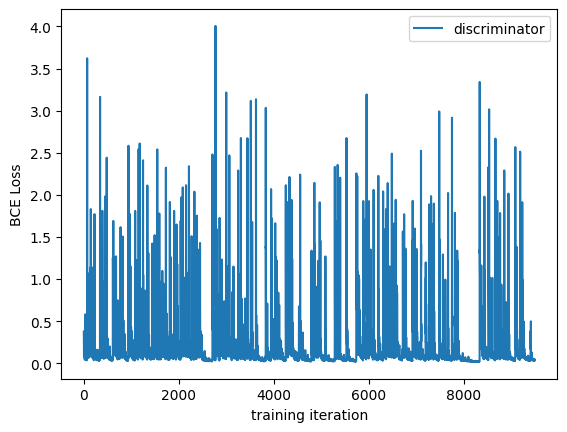

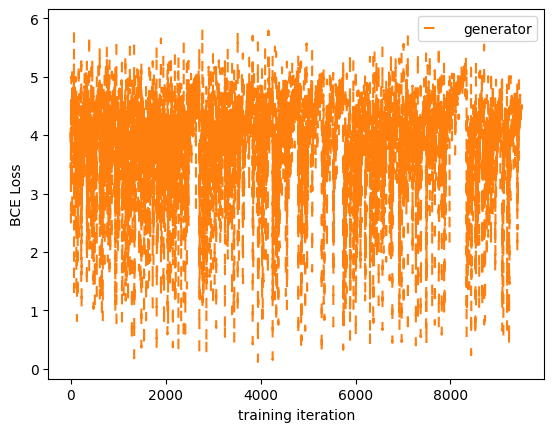

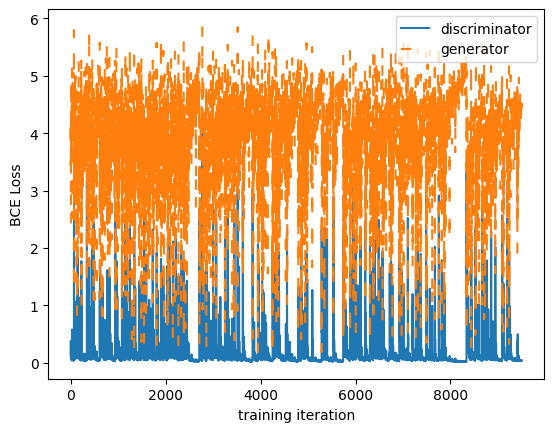

In [ ]:
plot_losses(d_losses, g_losses, 'all')

First 3 epochs of good TRAINING

21507
epoch: 0 repeat:  615 ------------------------------
weights saved


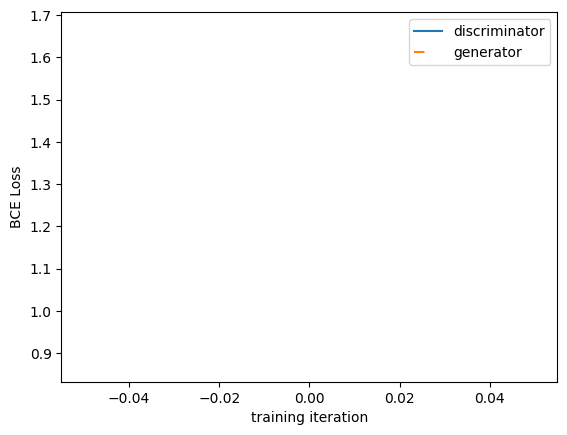

i=0, loss: 1.667580  0.871898


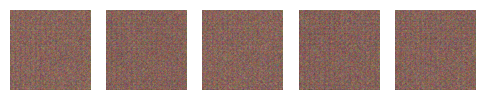

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00072/img00000728.png
i=50, loss: 1.153953  0.716129


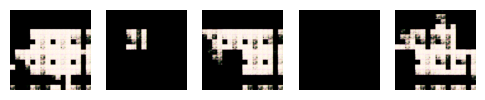

i=100, loss: 0.848925  1.342467


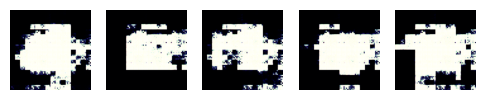

i=150, loss: 0.634953  1.695050


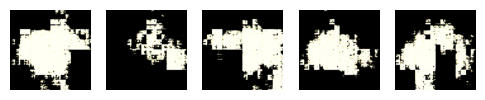

weights saved
i=200, loss: 0.237651  2.220711


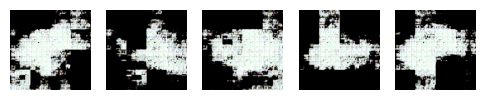

i=250, loss: 0.356867  1.804204


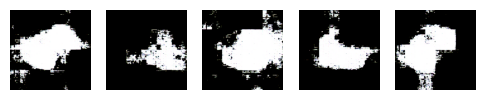

i=300, loss: 0.209578  2.559508


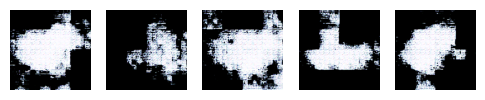

i=350, loss: 0.412738  1.438375


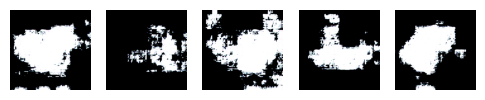

weights saved
i=400, loss: 0.192666  2.752644


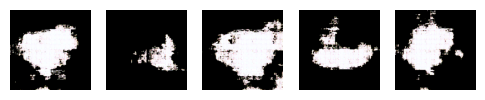

i=450, loss: 0.131348  3.119236


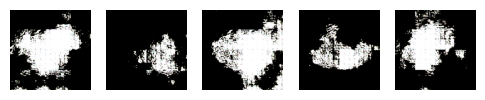

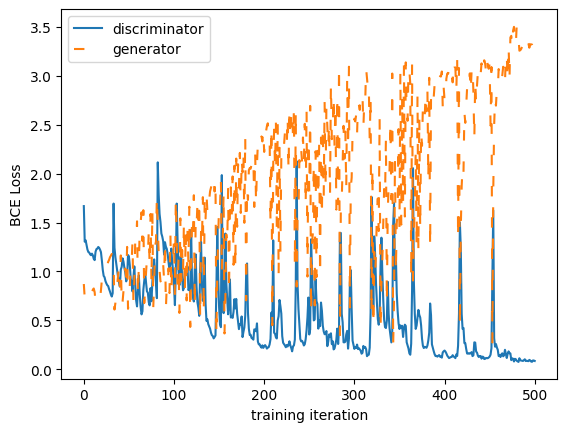

i=500, loss: 0.086502  3.330780


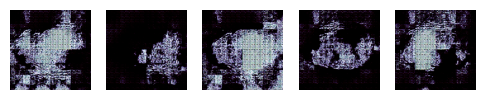

i=550, loss: 0.061500  3.441118


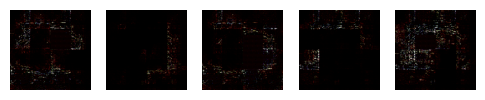

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00089/img00000473.png
weights saved
i=600, loss: 0.047844  3.721880


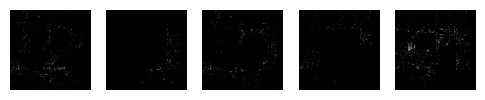

i=650, loss: 0.046174  3.758368


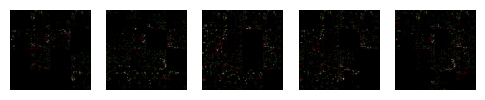

i=700, loss: 1.400982  3.402605


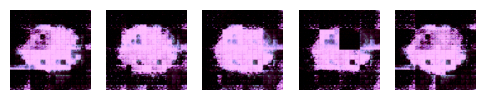

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00089/img00000503.png
i=750, loss: 0.091488  3.643203


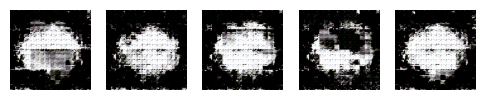

weights saved
i=800, loss: 1.151491  1.997629


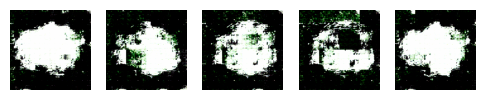

i=850, loss: 0.310635  1.846390


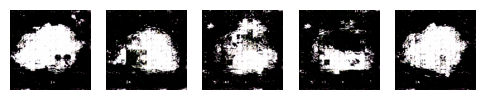

i=900, loss: 0.073958  3.535428


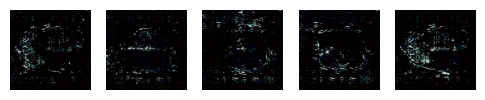

i=950, loss: 0.037789  3.909311


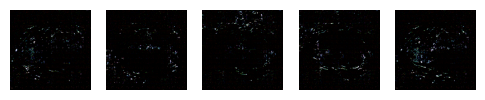

weights saved


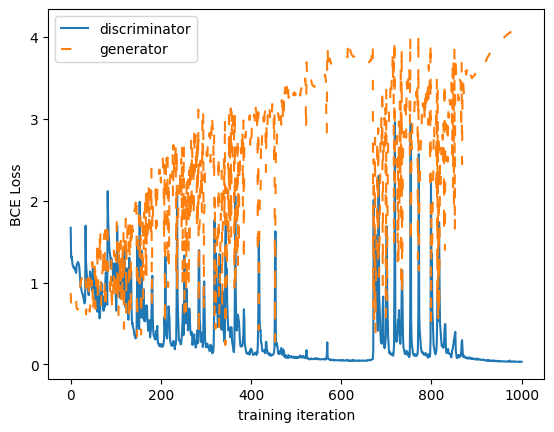

i=1000, loss: 0.032856  4.130951


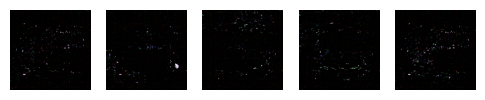

i=1050, loss: 0.027916  4.248886


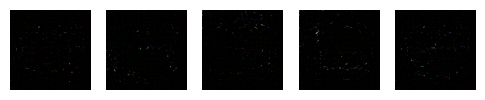

i=1100, loss: 0.027303  4.337467


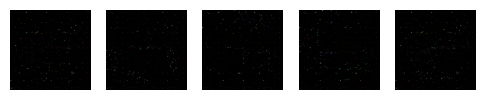

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00044/img00000576.png
i=1150, loss: 0.023156  4.395644


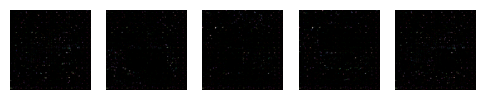

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00078/img00000776.png
weights saved
i=1200, loss: 0.022728  4.405450


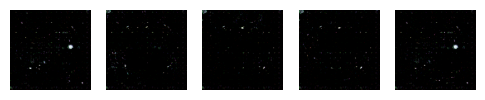

i=1250, loss: 0.401574  2.731255


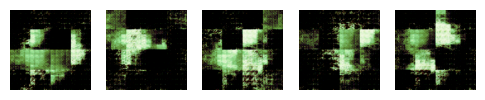

i=1300, loss: 0.087924  3.749402


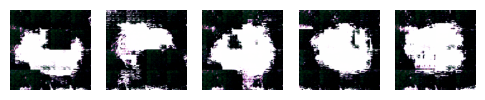

i=1350, loss: 0.162150  1.749998


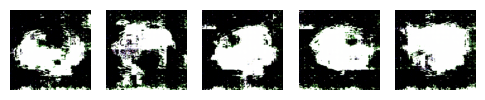

weights saved
i=1400, loss: 0.624825  0.270720


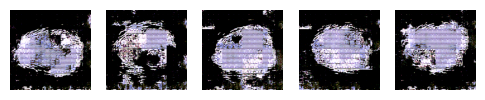

i=1450, loss: 0.050173  3.766685


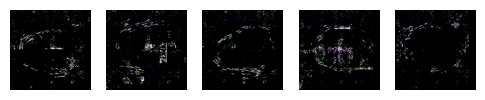

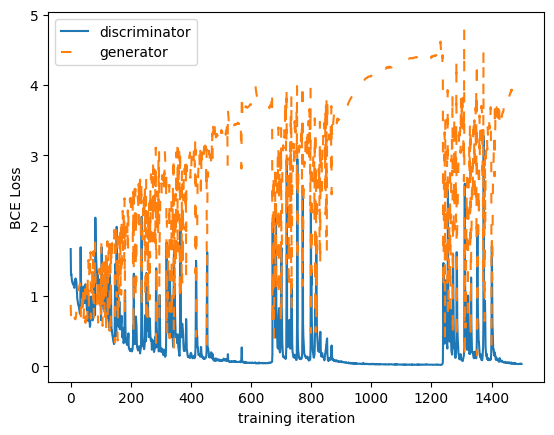

i=1500, loss: 0.034460  4.138662


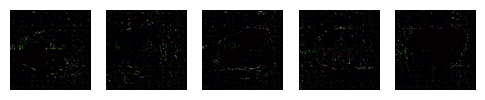

i=1550, loss: 0.026057  4.367176


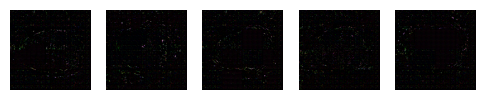

weights saved
i=1600, loss: 0.025043  4.432508


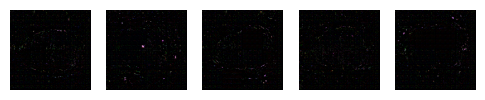

i=1650, loss: 0.028004  4.515281


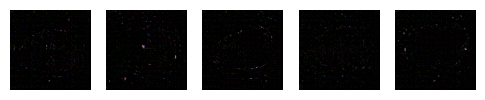

i=1700, loss: 0.026847  4.575397


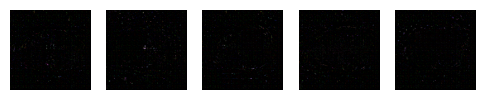

i=1750, loss: 0.019258  4.668888


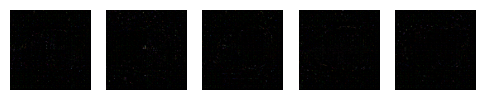

weights saved
i=1800, loss: 0.018977  4.729772


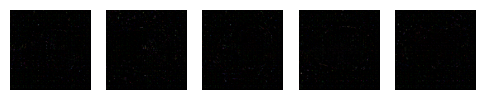

i=1850, loss: 0.015982  4.862927


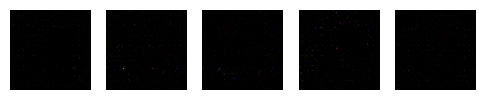

i=1900, loss: 0.023027  4.505084


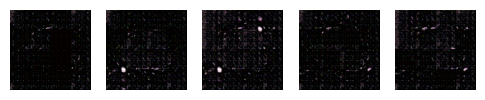

i=1950, loss: 0.401227  2.150947


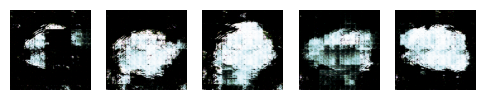

weights saved


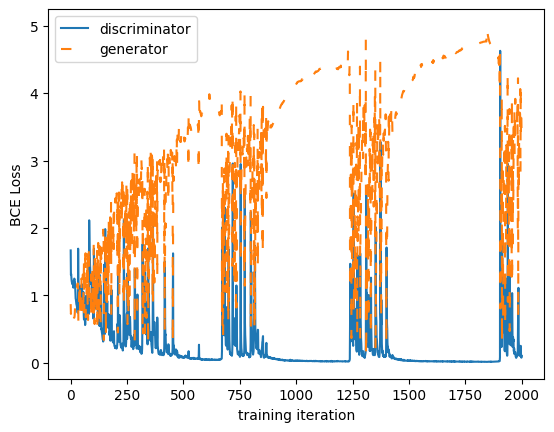

i=2000, loss: 0.104917  3.383008


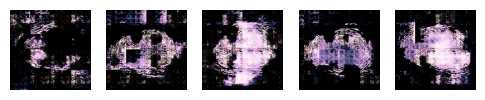

i=2050, loss: 0.028572  4.316117


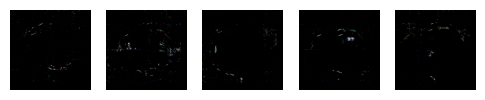

i=2100, loss: 0.035745  4.166697


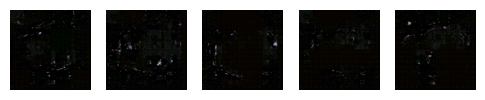

i=2150, loss: 0.540050  1.950994


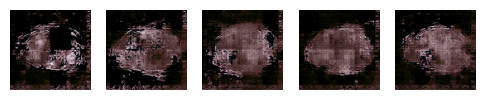

weights saved
i=2200, loss: 0.388407  3.221747


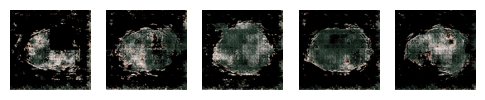

i=2250, loss: 0.262222  2.567672


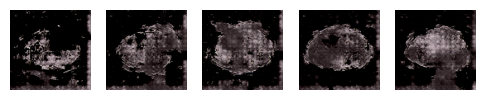

i=2300, loss: 0.511338  1.382260


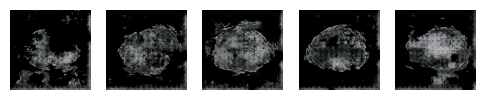

i=2350, loss: 0.186847  3.128401


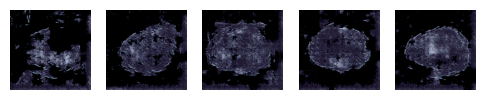

weights saved
i=2400, loss: 0.453389  2.389065


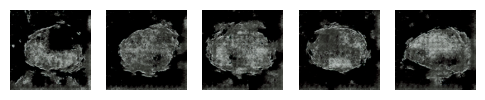

i=2450, loss: 0.402821  2.267551


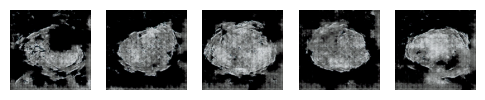

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00071/img00000725.png
epoch: 1 repeat:  308 ------------------------------
weights saved


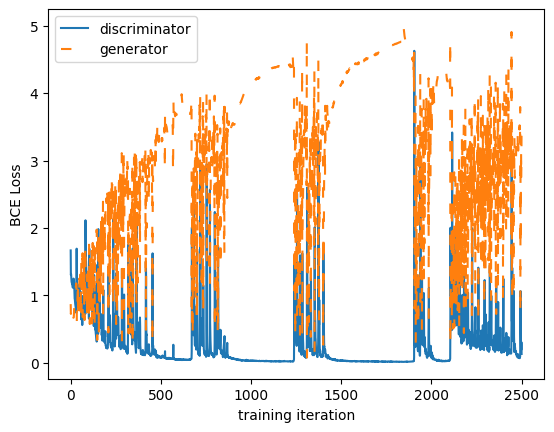

i=0, loss: 0.133611  3.536409


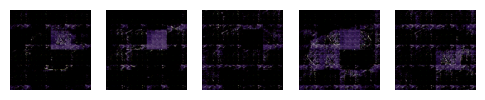

i=50, loss: 0.053872  3.849187


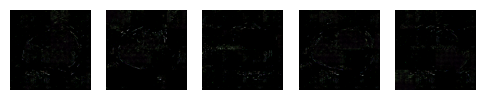

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00072/img00000728.png
i=100, loss: 1.024116  0.990496


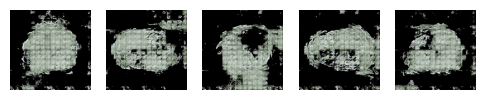

i=150, loss: 0.189339  2.333693


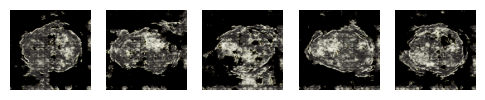

weights saved
i=200, loss: 0.286358  3.038045


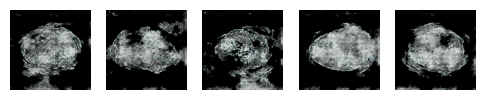

i=250, loss: 0.230490  4.277047


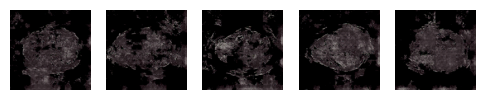

i=300, loss: 0.174723  3.408401


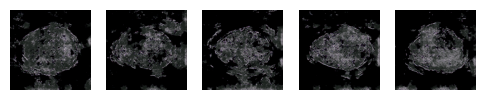

i=350, loss: 0.161697  3.258030


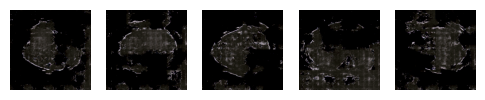

weights saved
i=400, loss: 0.216025  3.520199


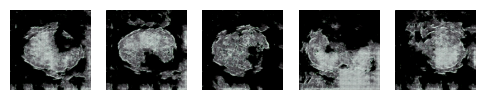

i=450, loss: 0.134258  3.074718


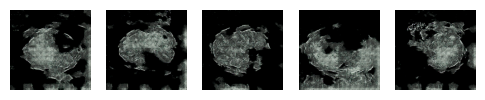

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00007/img00000344.png
bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00078/img00000588.png


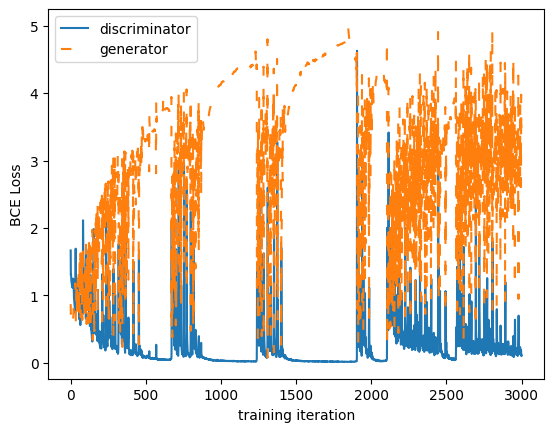

i=500, loss: 0.111445  3.413557


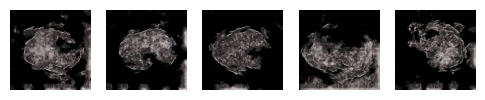

i=550, loss: 0.152604  3.147865


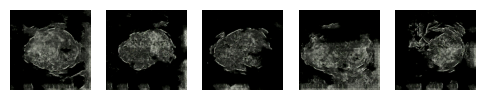

weights saved
i=600, loss: 0.746446  1.295332


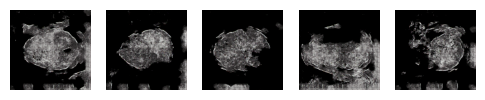

i=650, loss: 0.135313  3.437215


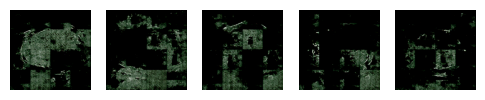

i=700, loss: 0.529770  4.409416


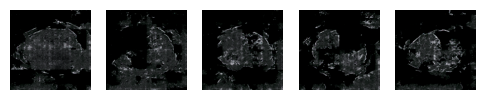

i=750, loss: 0.108324  3.609624


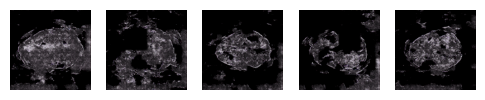

weights saved
i=800, loss: 0.216830  2.839851


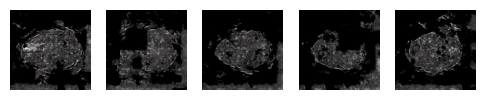

i=850, loss: 0.162853  3.305305


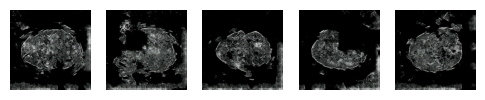

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00078/img00000588.png
i=900, loss: 0.305505  4.259427


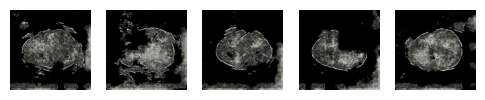

i=950, loss: 0.073219  3.723131


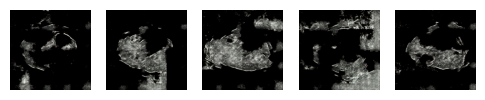

weights saved


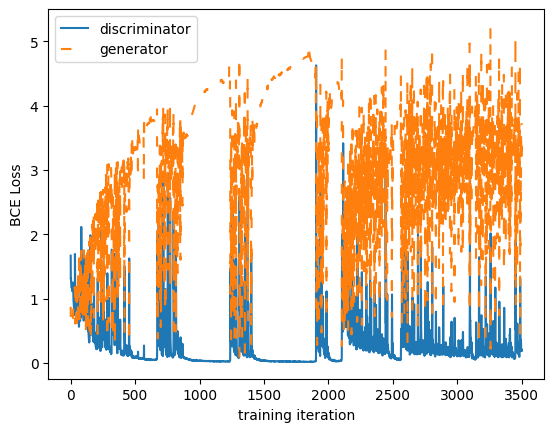

i=1000, loss: 0.185593  3.726826


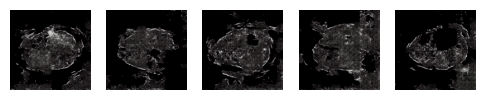

i=1050, loss: 0.239680  3.170597


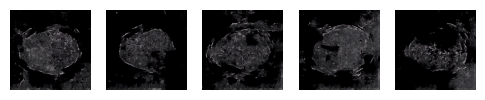

i=1100, loss: 0.162071  2.903810


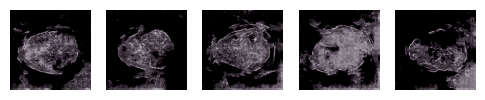

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00089/img00000502.png
bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00044/img00000576.png
i=1150, loss: 0.115003  4.343587


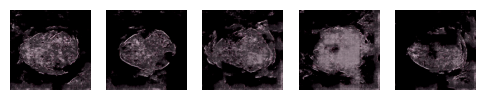

weights saved
i=1200, loss: 0.109882  3.690067


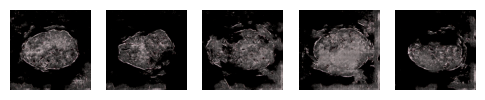

i=1250, loss: 0.084675  3.805330


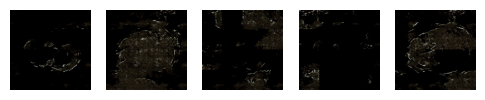

i=1300, loss: 0.040397  4.031034


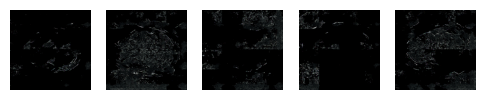

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00089/img00000184.png
i=1350, loss: 0.151255  4.105243


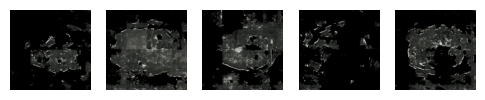

weights saved
i=1400, loss: 0.155034  3.695904


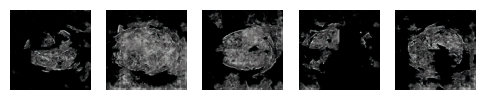

i=1450, loss: 0.083998  3.718466


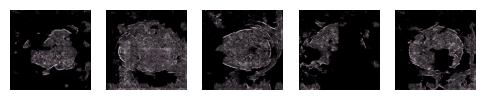

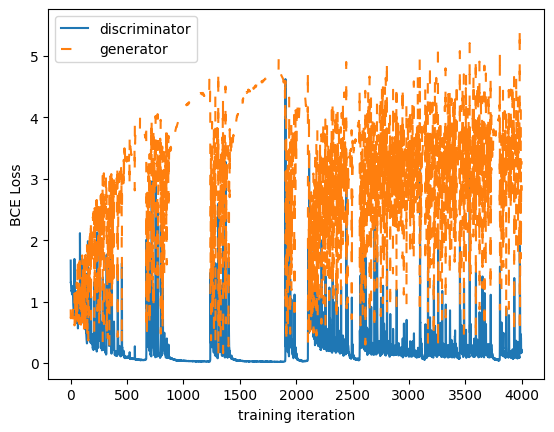

i=1500, loss: 0.174096  3.287831


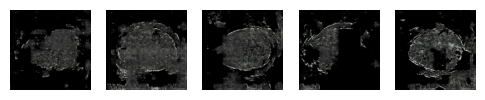

i=1550, loss: 0.086236  3.753269


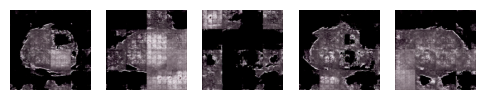

weights saved
i=1600, loss: 0.202723  3.412286


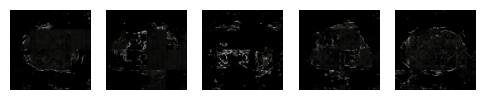

i=1650, loss: 0.095562  3.735317


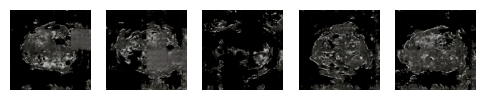

i=1700, loss: 0.124065  3.375612


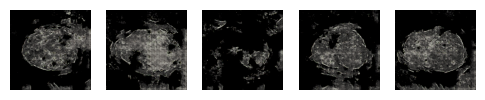

i=1750, loss: 0.208755  3.204549


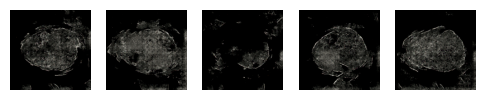

weights saved
i=1800, loss: 0.238450  3.164293


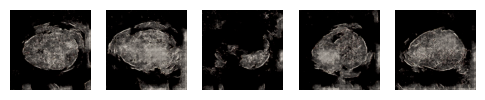

i=1850, loss: 0.328043  3.198089


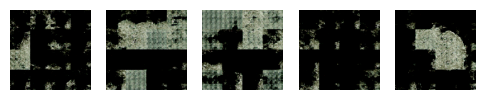

i=1900, loss: 0.067726  3.761431


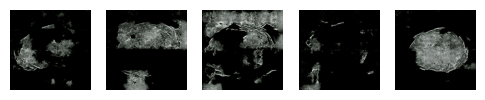

i=1950, loss: 0.068031  3.729593


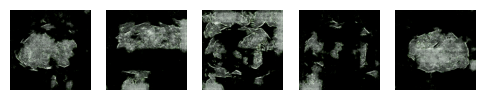

weights saved


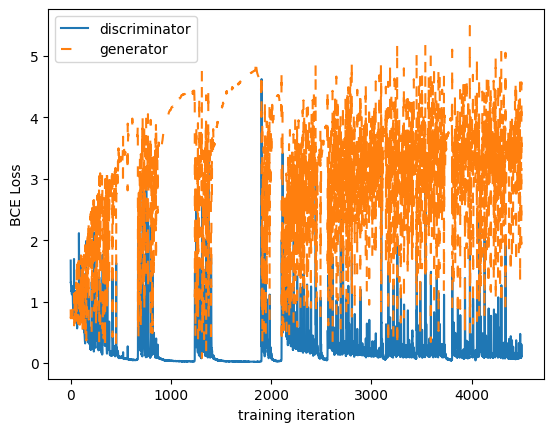

i=2000, loss: 0.111983  3.131626


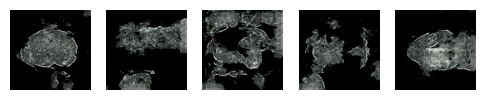

i=2050, loss: 0.094587  3.461440


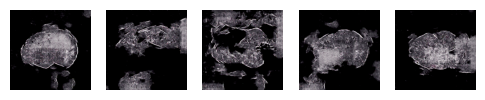

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00089/img00000473.png
i=2100, loss: 0.317121  2.573440


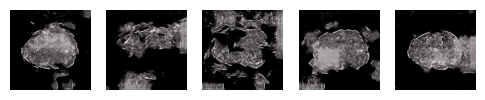

i=2150, loss: 0.106884  3.726901


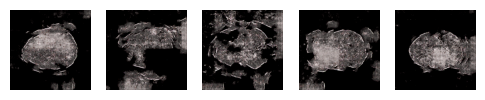

weights saved
i=2200, loss: 0.138914  4.260996


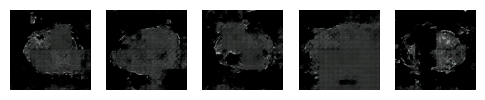

i=2250, loss: 0.130020  2.132249


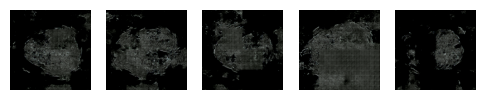

i=2300, loss: 0.132161  2.074781


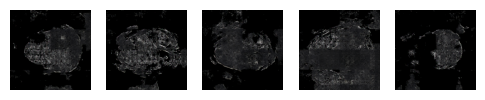

i=2350, loss: 0.084625  3.549878


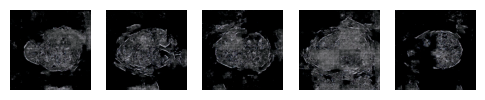

weights saved
i=2400, loss: 0.173895  2.039224


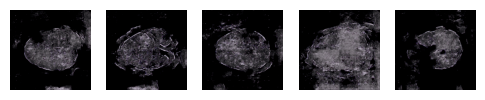

i=2450, loss: 0.087746  3.665114


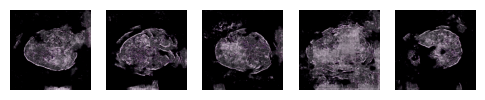

epoch: 2 repeat:  154 ------------------------------
weights saved


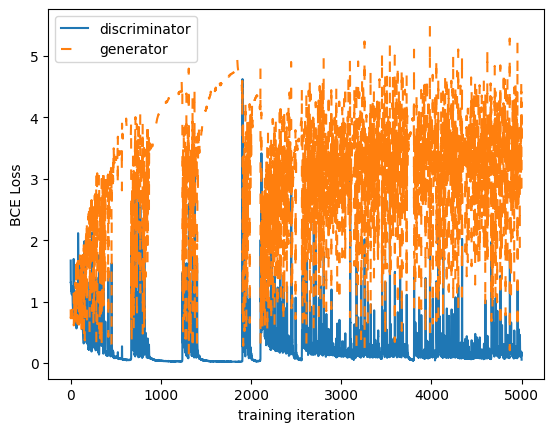

i=0, loss: 0.052060  4.423303


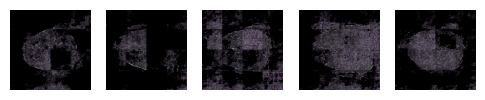

i=50, loss: 0.175262  3.564976


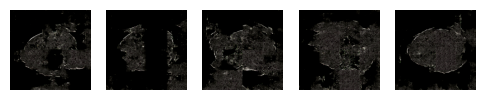

i=100, loss: 0.140380  3.384258


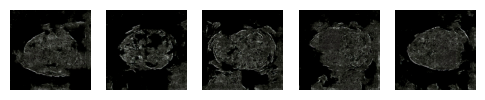

i=150, loss: 0.090181  3.807250


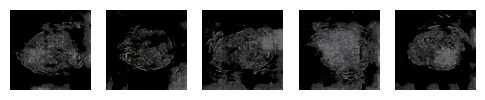

weights saved
i=200, loss: 0.123523  3.431193


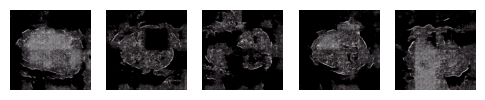

i=250, loss: 0.108578  3.277643


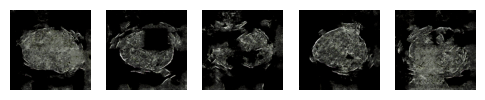

i=300, loss: 0.193388  2.986575


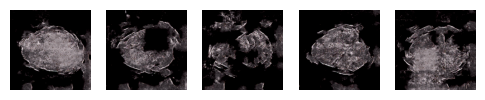

i=350, loss: 1.104432  2.886307


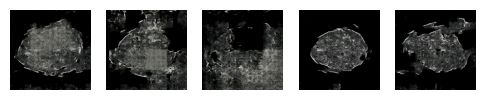

weights saved
i=400, loss: 0.114374  3.287868


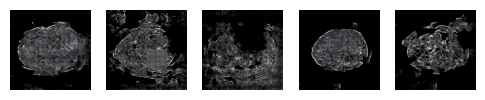

i=450, loss: 0.097373  3.220507


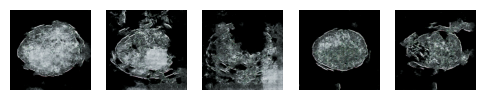

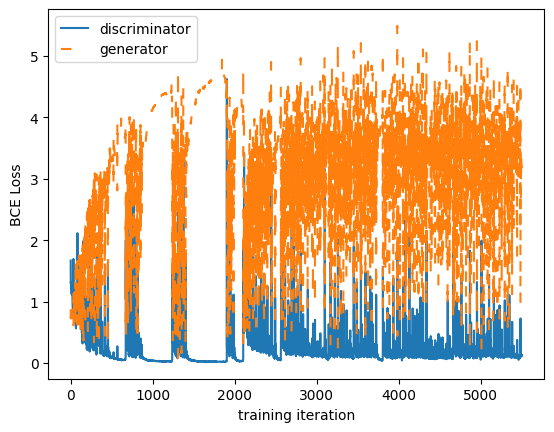

i=500, loss: 0.127229  3.172273


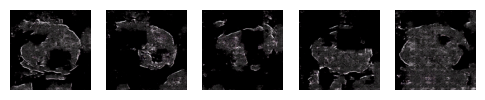

i=550, loss: 0.090054  3.469224


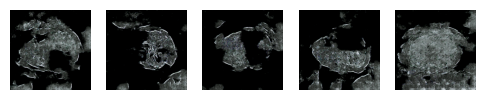

weights saved
i=600, loss: 0.072743  3.594870


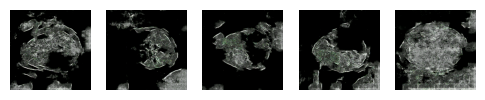

i=650, loss: 0.122494  3.786192


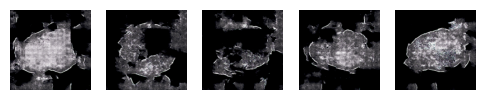

i=700, loss: 0.132507  4.020520


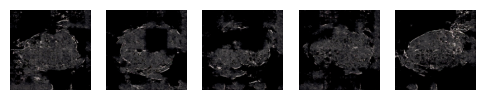

i=750, loss: 0.078593  4.027825


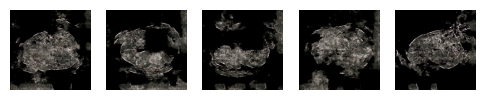

weights saved
i=800, loss: 0.634794  1.633334


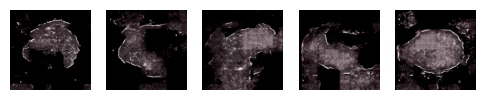

i=850, loss: 0.174693  3.100966


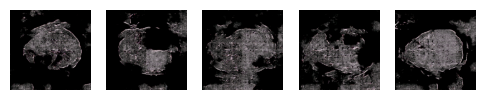

i=900, loss: 0.100878  3.395288


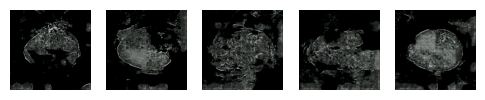

i=950, loss: 0.169372  3.385260


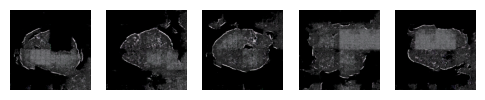

weights saved


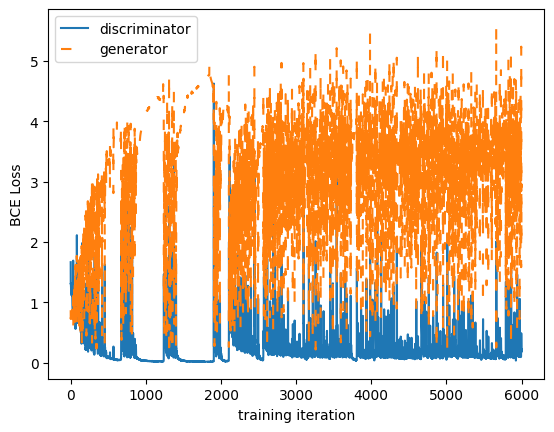

i=1000, loss: 0.222226  2.712518


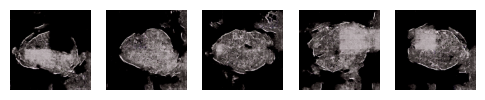

i=1050, loss: 0.111697  3.449452


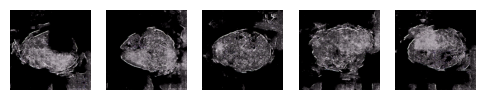

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00089/img00000184.png
i=1100, loss: 0.085764  3.325597


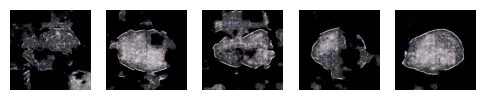

i=1150, loss: 0.138527  3.761160


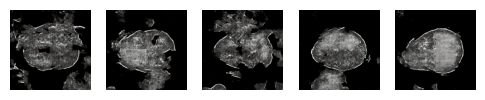

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00044/img00000576.png
weights saved
i=1200, loss: 0.744362  1.512899


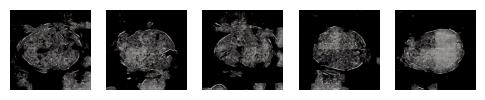

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00089/img00000503.png
bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00020/img00000348.png
i=1250, loss: 0.167071  4.516578


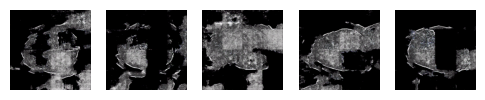

i=1300, loss: 0.080230  3.677698


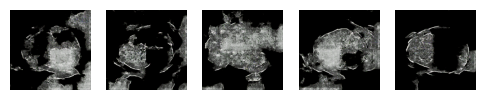

i=1350, loss: 0.102142  3.481715


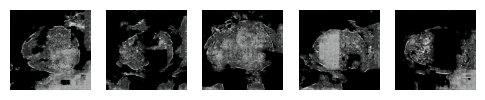

weights saved
i=1400, loss: 0.113420  3.444740


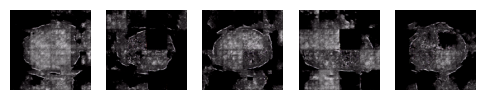

i=1450, loss: 0.554190  4.947443


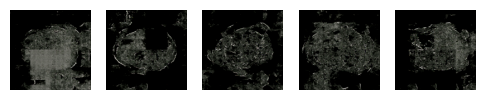

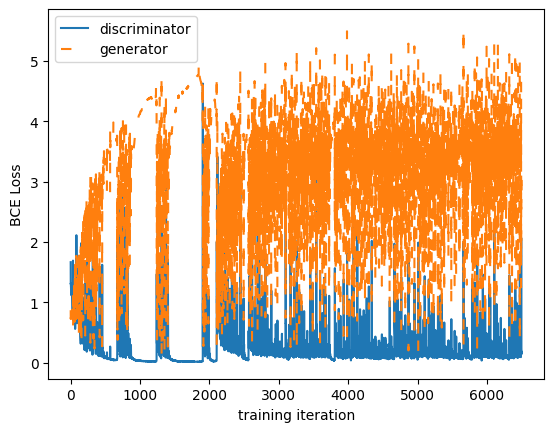

i=1500, loss: 0.182566  2.758564


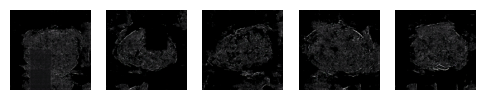

i=1550, loss: 0.168222  4.245156


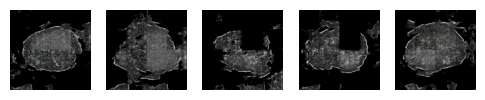

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00089/img00000423.png
weights saved
i=1600, loss: 0.259006  2.798114


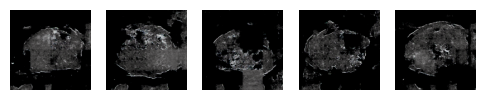

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00007/img00000344.png
i=1650, loss: 0.046992  3.873499


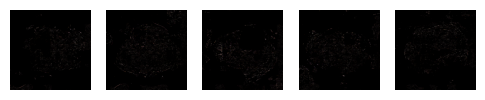

i=1700, loss: 0.030185  4.357238


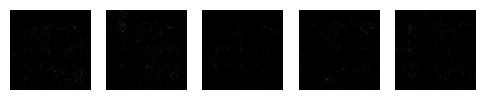

i=1750, loss: 0.029972  4.515641


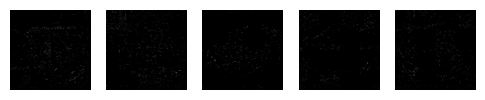

weights saved
i=1800, loss: 0.022376  4.668132


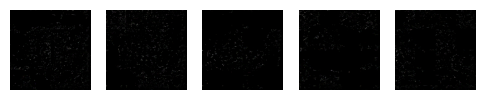

i=1850, loss: 0.018916  4.957945


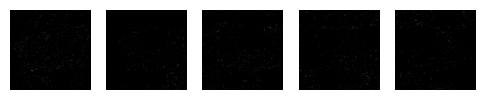

i=1900, loss: 0.019269  4.784330


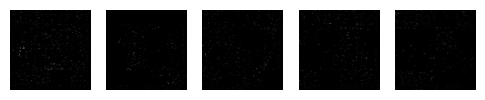

i=1950, loss: 0.018984  4.812541


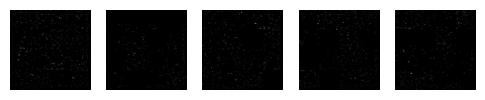

weights saved


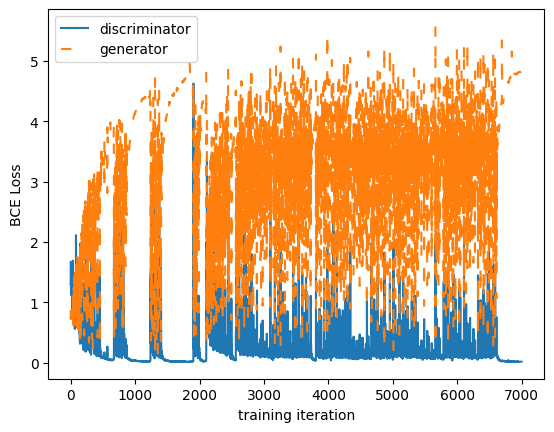

i=2000, loss: 0.019621  4.825728


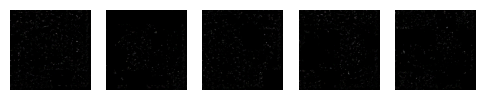

i=2050, loss: 0.018355  4.855489


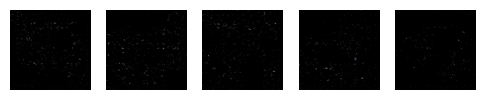

i=2100, loss: 0.017448  4.874656


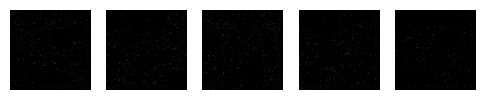

i=2150, loss: 0.017252  4.912117


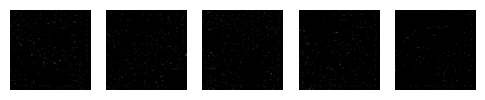

weights saved
i=2200, loss: 0.016986  4.899684


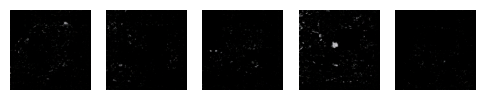

i=2250, loss: 0.017120  4.875541


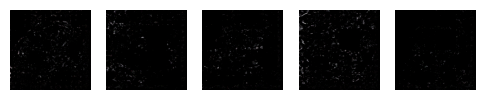

i=2300, loss: 0.016285  4.877971


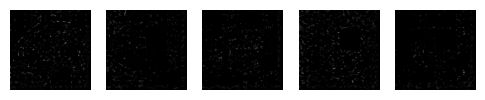

i=2350, loss: 1.825139  1.089638


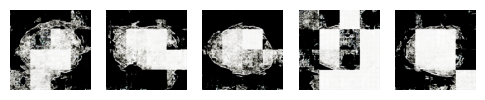

weights saved
i=2400, loss: 0.037305  4.159313


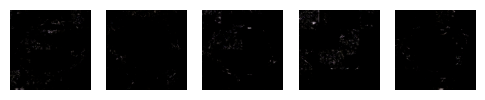

i=2450, loss: 0.028619  4.531136


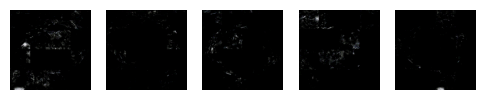

epoch: 3 repeat:  77 ------------------------------
weights saved


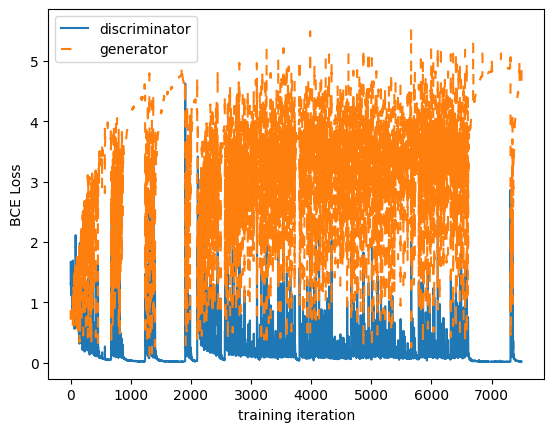

i=0, loss: 0.017917  5.169570


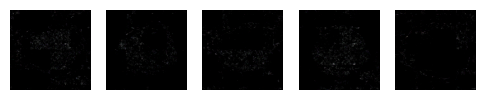

i=50, loss: 0.550463  4.109068


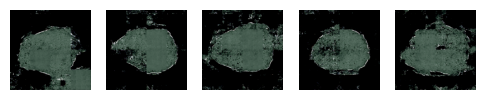

i=100, loss: 0.204723  3.793077


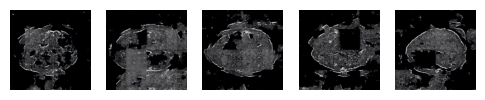

i=150, loss: 0.271047  2.964225


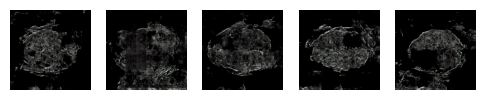

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00089/img00000423.png
weights saved
i=200, loss: 0.253405  2.579902


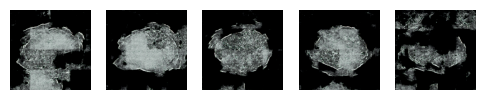

i=250, loss: 0.246089  3.261798


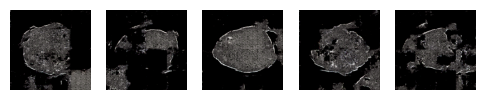

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00089/img00000423.png
i=300, loss: 0.122611  3.452478


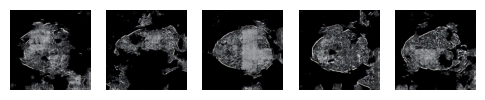

i=350, loss: 0.170069  3.867041


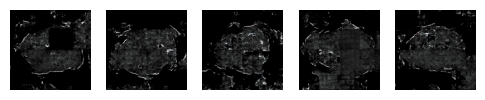

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00089/img00000503.png
weights saved
i=400, loss: 0.487824  2.542560


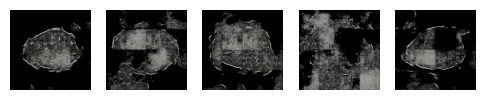

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00089/img00000503.png
i=450, loss: 0.172766  2.942594


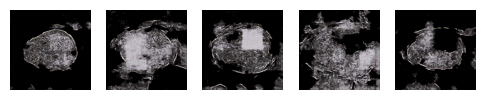

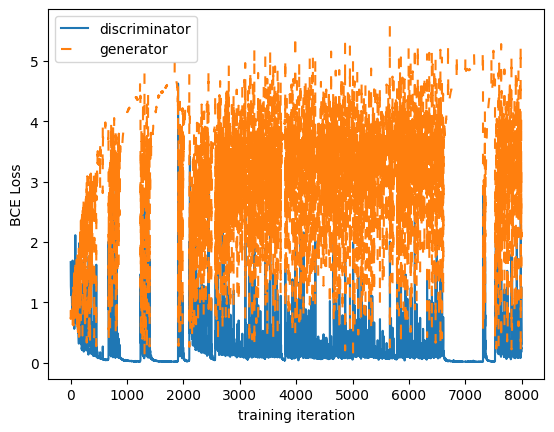

i=500, loss: 0.190783  3.145031


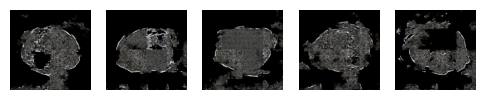

i=550, loss: 0.275827  2.855776


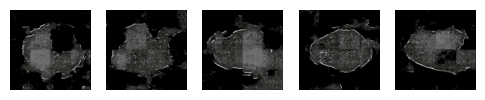

weights saved
i=600, loss: 0.096490  3.663982


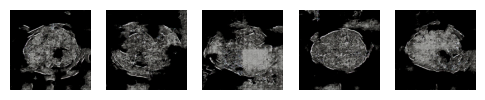

i=650, loss: 0.114560  3.678874


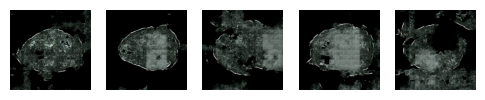

i=700, loss: 0.242174  2.657657


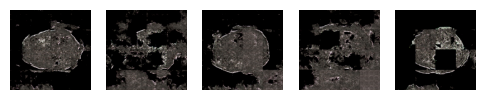

i=750, loss: 0.097901  3.269756


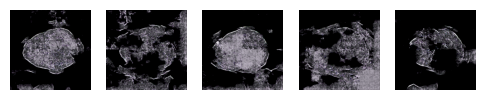

weights saved
i=800, loss: 0.133433  3.702822


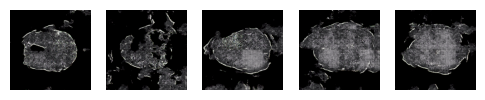

i=850, loss: 0.424751  2.782094


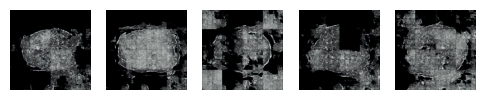

i=900, loss: 0.280060  3.287954


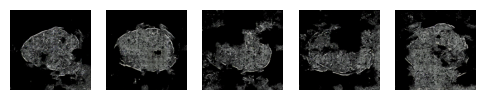

i=950, loss: 0.152914  3.392268


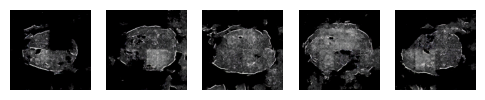

weights saved


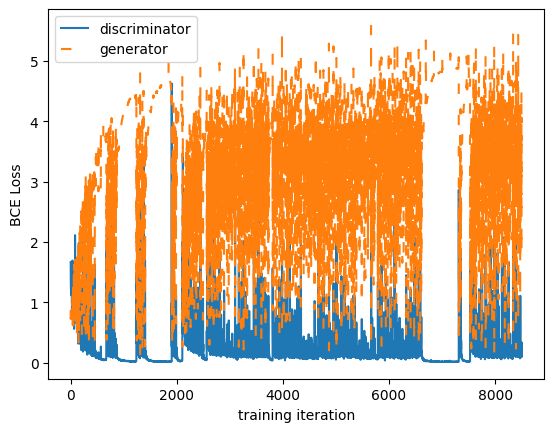

i=1000, loss: 0.123631  3.849636


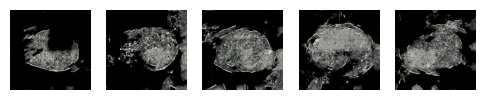

i=1050, loss: 0.100649  3.481469


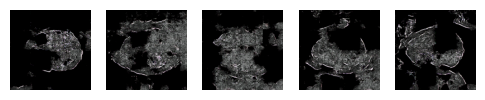

i=1100, loss: 0.106065  4.112017


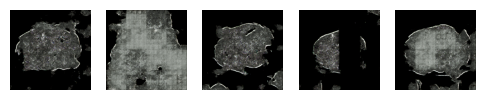

i=1150, loss: 0.097101  3.516653


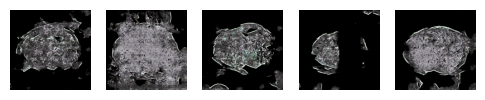

weights saved
i=1200, loss: 0.262870  2.372931


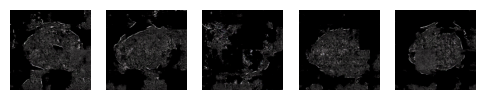

i=1250, loss: 1.066584  0.751659


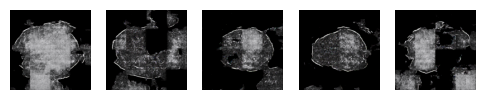

i=1300, loss: 0.085256  3.766570


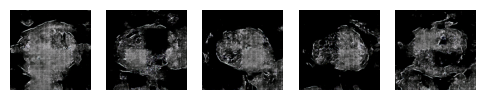

i=1350, loss: 0.081992  3.724307


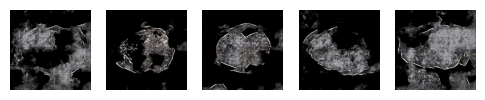

weights saved
i=1400, loss: 0.115675  3.359352


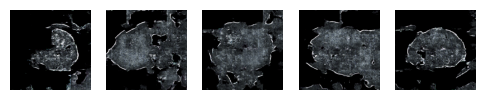

i=1450, loss: 0.081929  3.869169


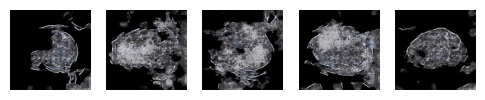

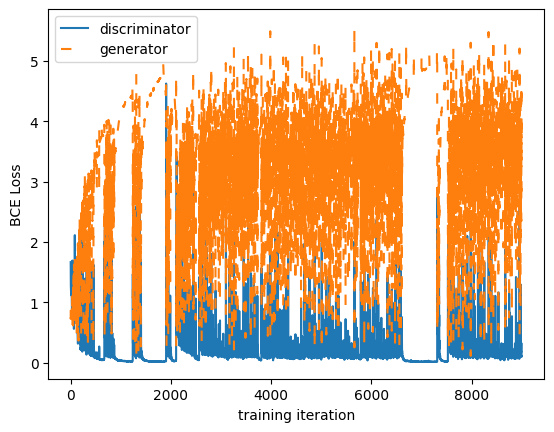

i=1500, loss: 0.115816  3.751531


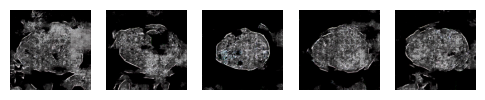

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00044/img00000576.png
i=1550, loss: 0.138278  3.385230


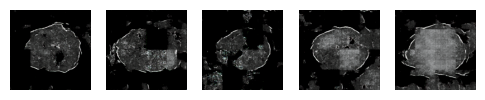

weights saved
i=1600, loss: 0.121229  3.268139


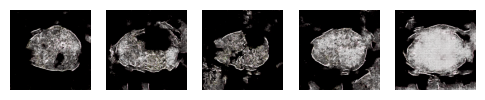

i=1650, loss: 0.069338  3.925120


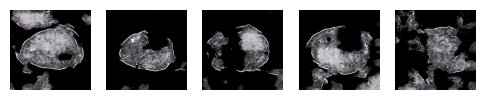

i=1700, loss: 0.823797  3.891705


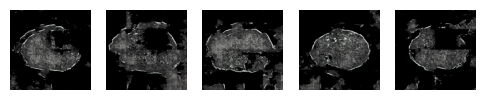

i=1750, loss: 0.103129  3.519977


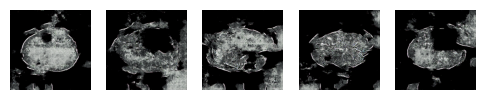

weights saved
i=1800, loss: 0.089334  3.755689


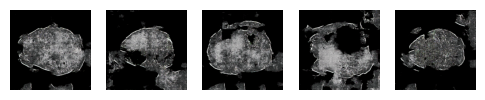

i=1850, loss: 0.106107  4.320275


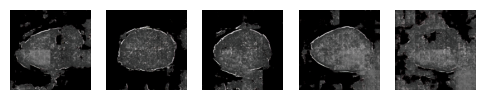

i=1900, loss: 0.092600  3.705166


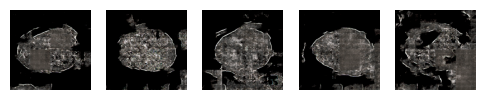

i=1950, loss: 0.085369  3.470742


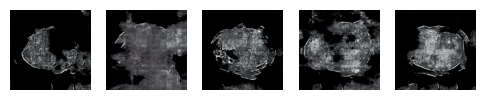

weights saved


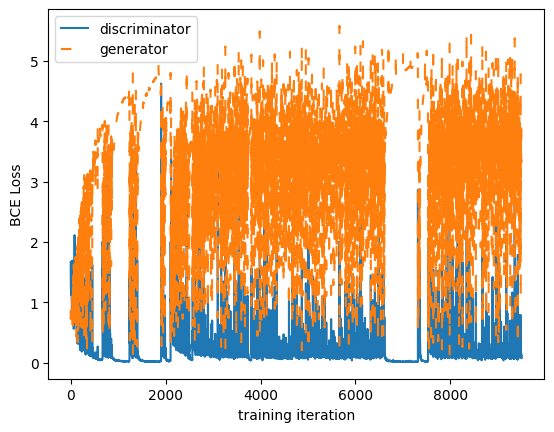

i=2000, loss: 0.081523  3.524475


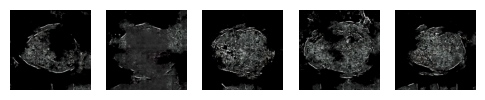

i=2050, loss: 0.090249  3.647369


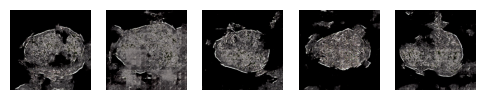

i=2100, loss: 0.192963  5.010426


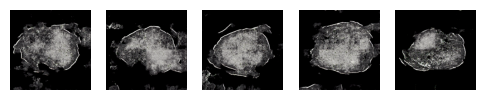

i=2150, loss: 0.107634  3.289348


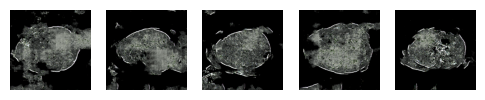

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00071/img00000725.png
weights saved
i=2200, loss: 0.105672  3.405077


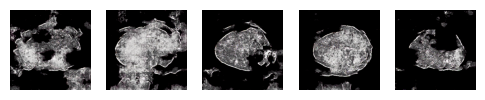

i=2250, loss: 0.245331  2.535330


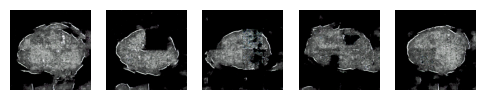

i=2300, loss: 0.087972  3.878326


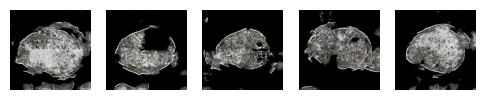

i=2350, loss: 0.191608  4.742668


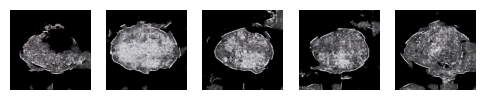

weights saved
i=2400, loss: 0.085846  3.656846


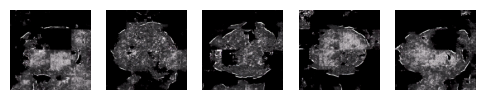

i=2450, loss: 0.052883  4.223588


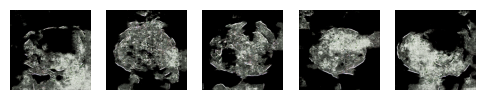

epoch: 4 repeat:  39 ------------------------------
weights saved


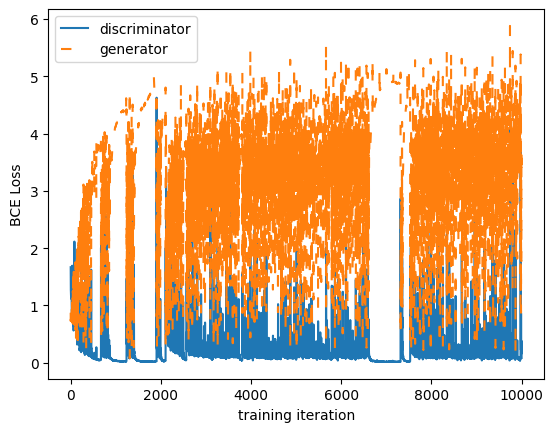

i=0, loss: 0.083463  3.804649


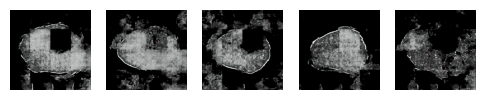

i=50, loss: 0.196661  3.376212


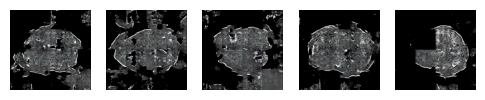

i=100, loss: 0.101680  3.460471


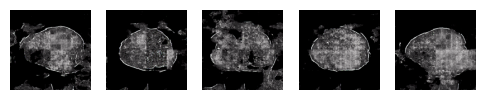

i=150, loss: 0.140454  3.158111


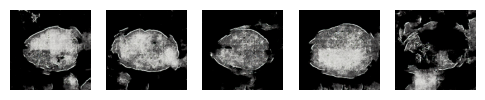

weights saved
i=200, loss: 0.168514  3.457563


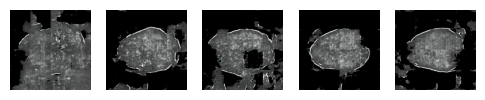

i=250, loss: 0.086211  3.661224


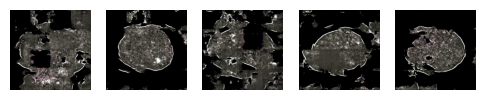

i=300, loss: 0.112132  3.764827


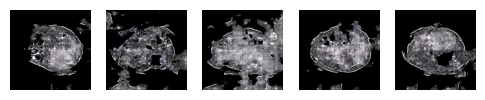

i=350, loss: 0.137617  3.463052


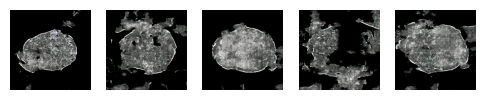

weights saved
i=400, loss: 0.104798  3.816317


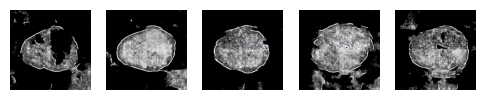

i=450, loss: 0.151511  3.058806


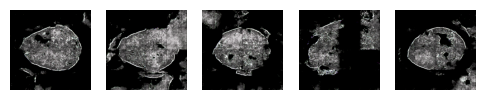

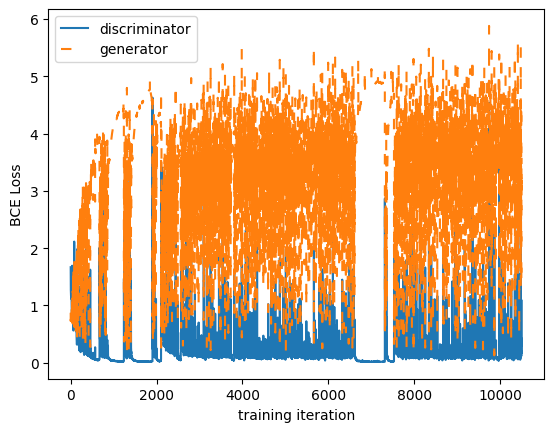

i=500, loss: 0.130890  3.576867


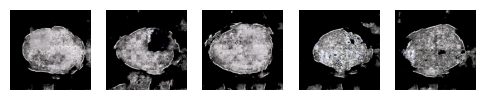

i=550, loss: 0.102086  3.589020


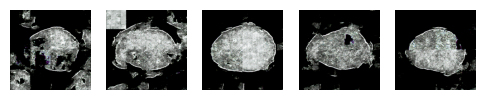

weights saved
i=600, loss: 0.183896  3.259589


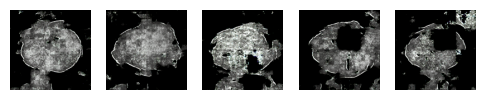

i=650, loss: 0.189590  2.768005


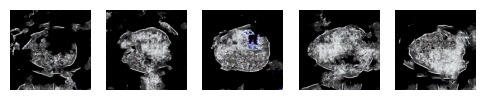

i=700, loss: 0.254712  4.189925


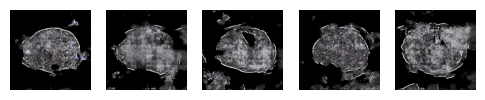

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00007/img00000344.png
bad file/content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00089/img00000473.png 
i=750, loss: 0.081605  3.965292


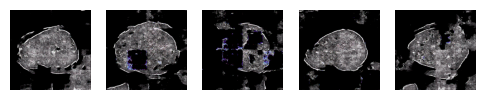

weights saved
i=800, loss: 0.526002  4.611835


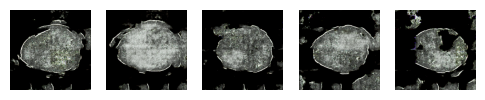

i=850, loss: 0.238228  2.874404


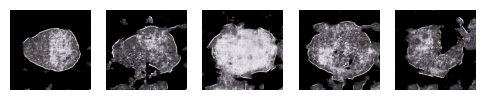

i=900, loss: 0.067645  3.997598


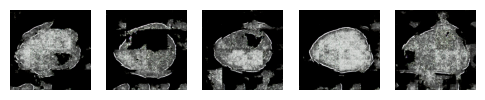

i=950, loss: 0.139158  4.247245


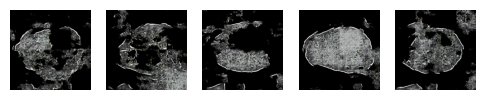

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00020/img00000348.png
weights saved


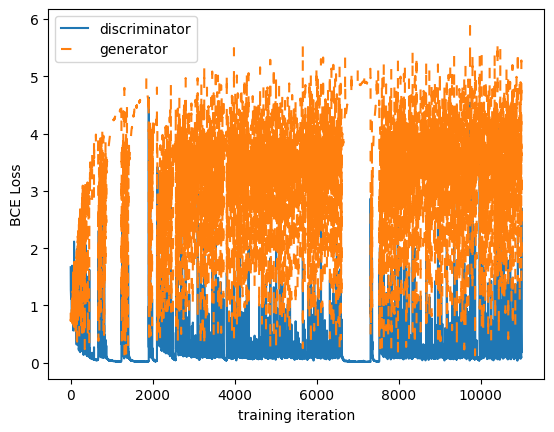

i=1000, loss: 0.187041  3.349518


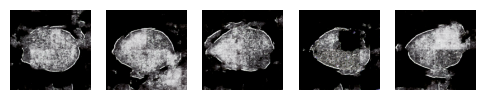

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00089/img00000063.png
i=1050, loss: 0.094632  4.180501


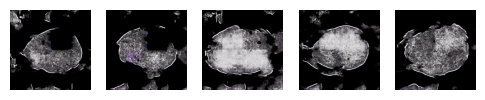

i=1100, loss: 0.093305  3.836061


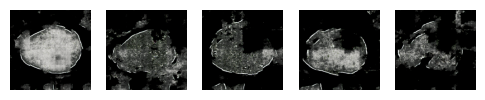

i=1150, loss: 0.128649  3.590492


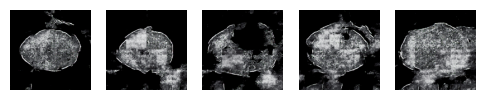

weights saved
i=1200, loss: 0.715972  3.915301


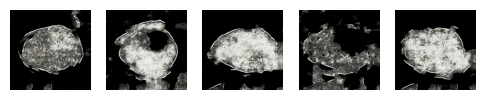

i=1250, loss: 0.150444  3.477074


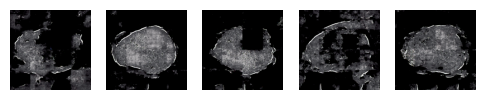

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00071/img00000725.png
i=1300, loss: 0.247378  4.987724


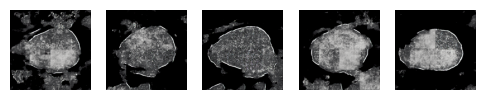

i=1350, loss: 0.108735  3.798937


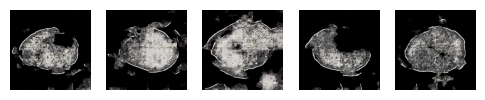

weights saved
i=1400, loss: 0.137983  4.015325


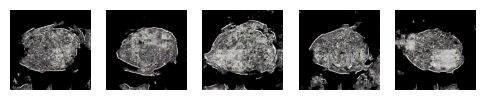

i=1450, loss: 0.209258  1.417428


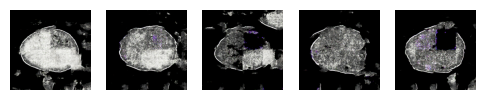

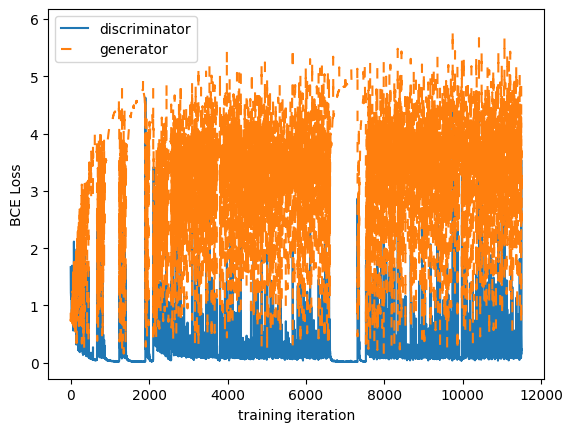

i=1500, loss: 0.162798  3.091835


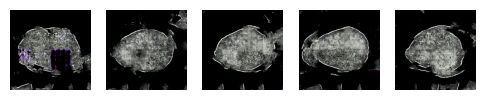

i=1550, loss: 0.083392  3.688637


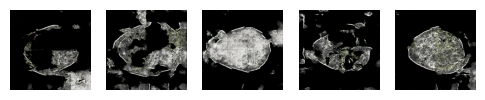

weights saved
i=1600, loss: 0.068063  3.983415


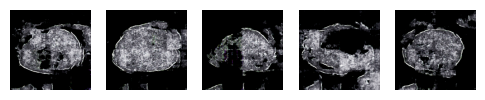

i=1650, loss: 2.076564  0.427383


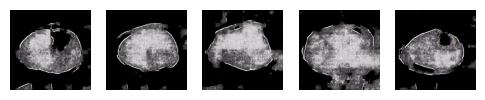

i=1700, loss: 0.209224  3.376494


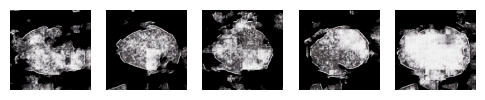

i=1750, loss: 0.068842  3.886946


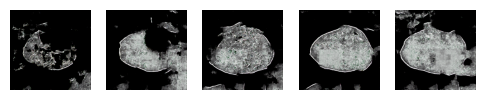

weights saved
i=1800, loss: 0.126337  3.600660


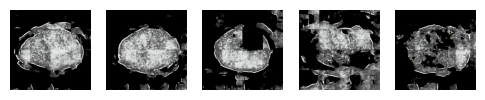

i=1850, loss: 0.215852  3.094483


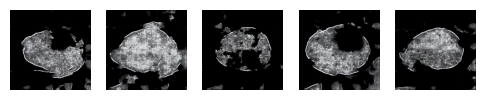

i=1900, loss: 0.099873  3.745789


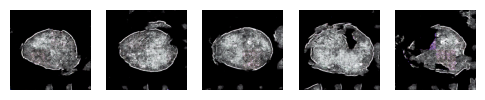

i=1950, loss: 0.042480  4.745189


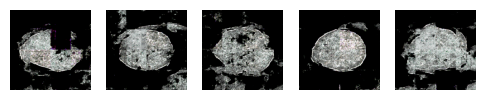

weights saved


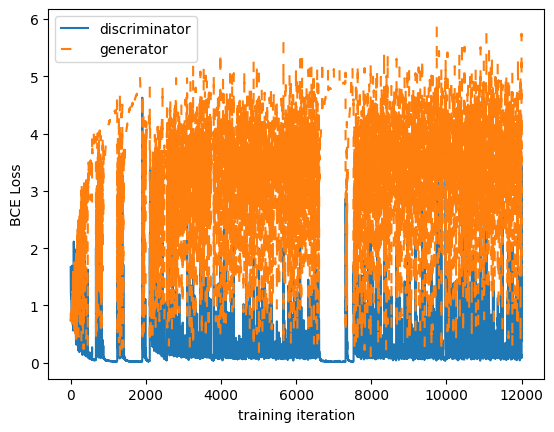

i=2000, loss: 0.388096  1.871684


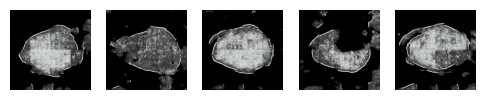

i=2050, loss: 0.130116  3.565356


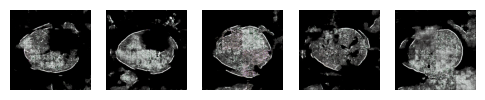

i=2100, loss: 0.132885  3.295625


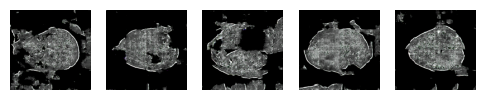

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00044/img00000576.png
i=2150, loss: 1.555387  4.177423


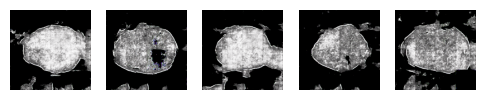

weights saved
i=2200, loss: 0.179822  3.490931


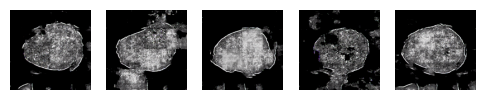

i=2250, loss: 0.136090  3.547546


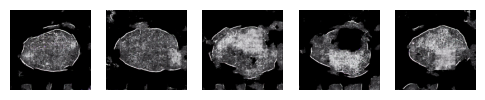

i=2300, loss: 0.076920  4.054365


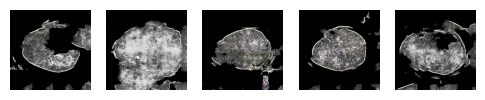

i=2350, loss: 0.109764  2.384525


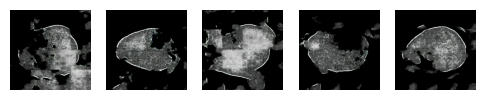

weights saved
i=2400, loss: 0.128088  3.453700


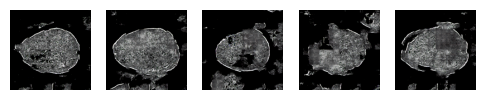

i=2450, loss: 0.134674  3.165487


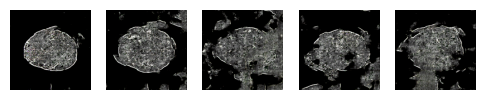

epoch: 5 repeat:  20 ------------------------------
weights saved


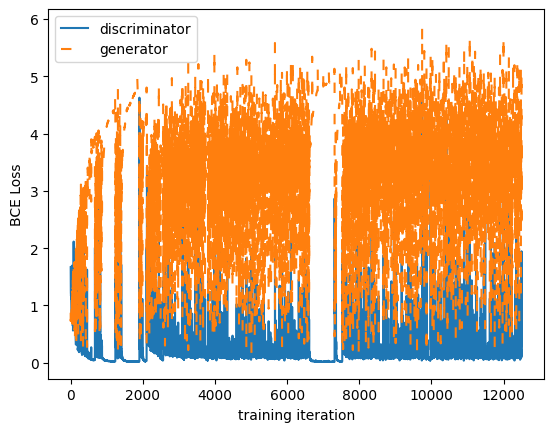

i=0, loss: 0.285109  3.372015


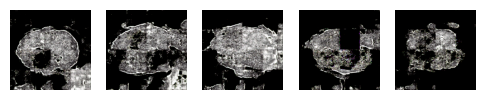

i=50, loss: 0.143390  2.544301


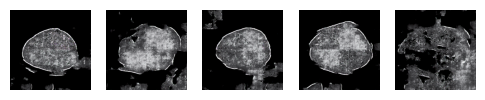

i=100, loss: 0.098898  4.328591


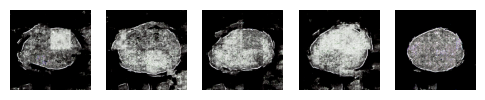

i=150, loss: 0.109125  3.527152


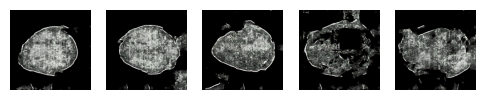

weights saved
i=200, loss: 0.057152  4.765633


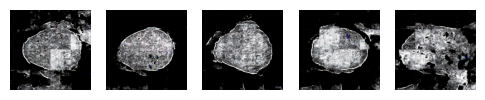

i=250, loss: 0.187427  3.797788


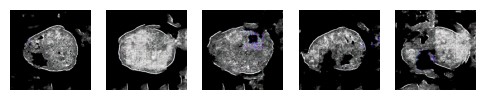

i=300, loss: 0.151492  3.559241


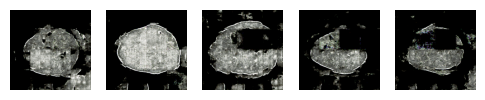

i=350, loss: 0.145865  3.799114


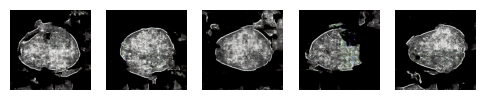

weights saved
i=400, loss: 0.054640  4.259202


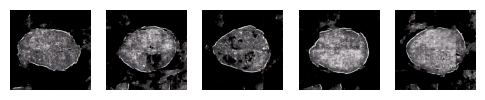

i=450, loss: 0.139654  3.271913


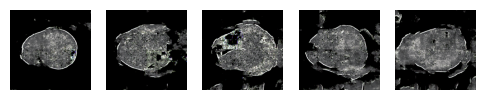

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00089/img00000901.png


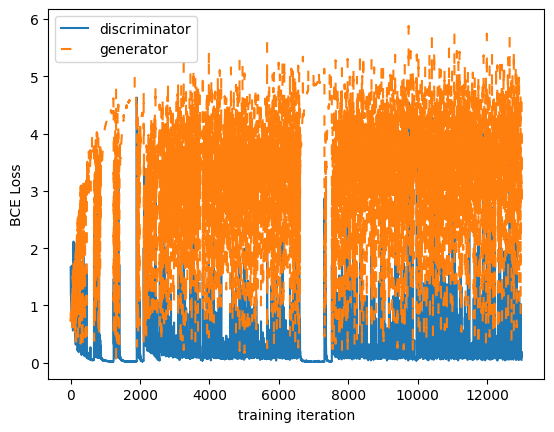

i=500, loss: 0.051684  4.739715


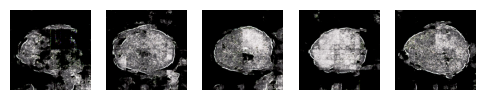

i=550, loss: 0.119639  3.365035


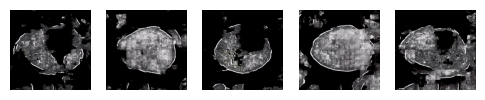

weights saved
i=600, loss: 0.051414  4.673381


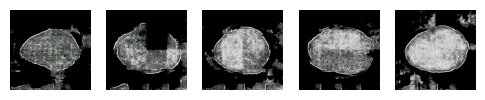

i=650, loss: 0.364762  4.848363


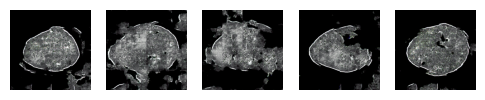

i=700, loss: 0.103484  4.626714


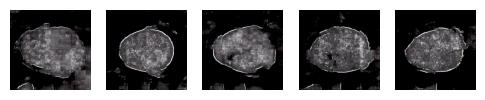

i=750, loss: 0.118924  3.661004


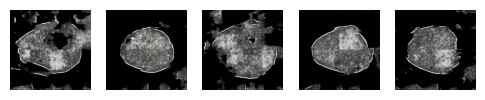

weights saved
i=800, loss: 0.208046  3.990384


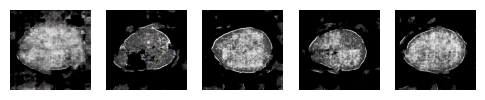

i=850, loss: 0.103098  3.620976


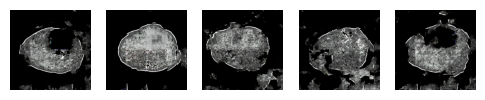

i=900, loss: 0.055155  4.321004


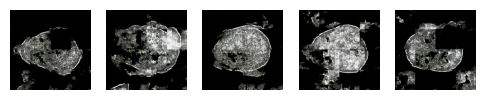

i=950, loss: 0.201906  4.199895


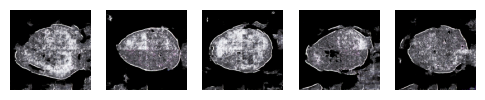

weights saved


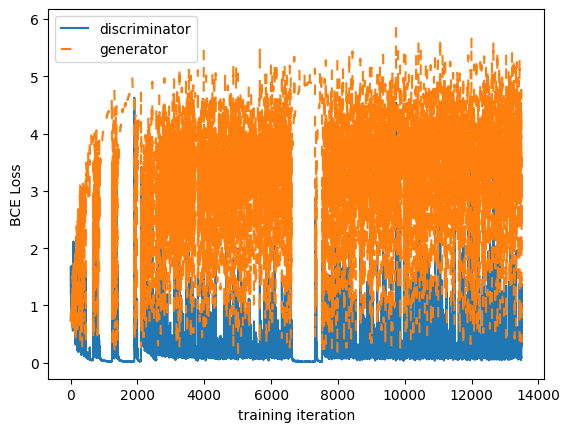

i=1000, loss: 0.389463  3.680439


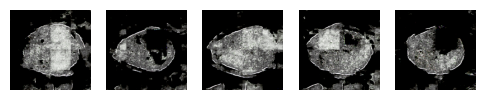

i=1050, loss: 0.100150  4.049927


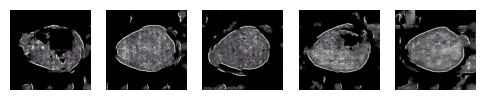

i=1100, loss: 0.120076  3.802326


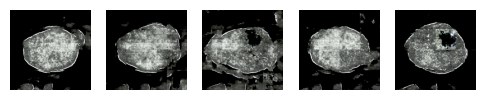

i=1150, loss: 0.134431  3.650382


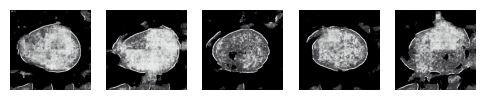

weights saved
i=1200, loss: 0.213811  4.556921


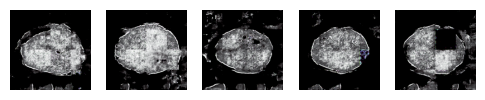

i=1250, loss: 0.108705  3.506564


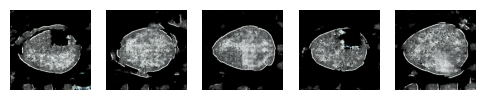

i=1300, loss: 0.299490  4.803718


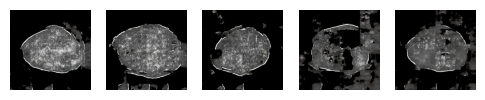

i=1350, loss: 0.222403  3.012229


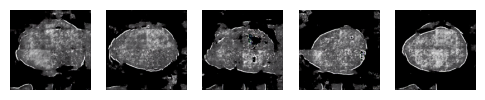

weights saved
i=1400, loss: 0.048196  4.767496


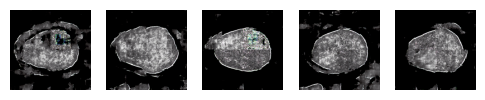

i=1450, loss: 0.154205  3.256011


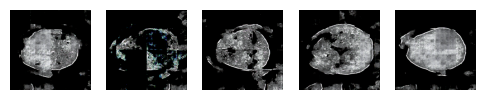

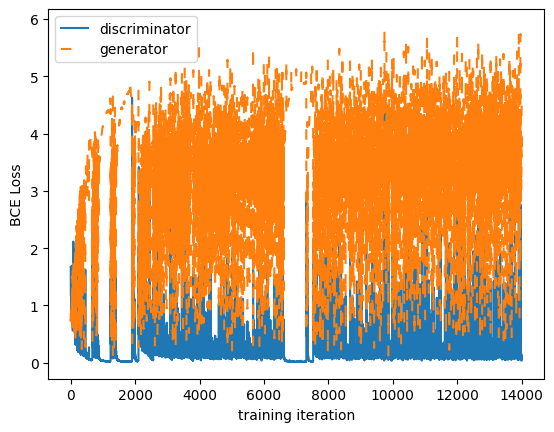

i=1500, loss: 0.039611  4.728597


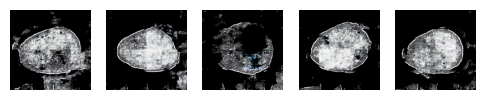

i=1550, loss: 0.094984  3.767482


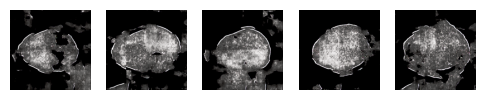

weights saved
i=1600, loss: 0.057035  4.269161


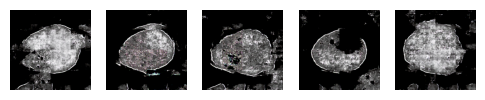

i=1650, loss: 0.133009  3.568268


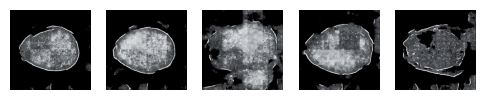

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00078/img00000588.png
i=1700, loss: 0.078613  4.628453


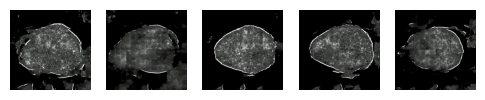

i=1750, loss: 0.137956  3.408909


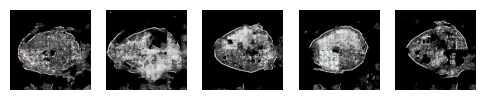

weights saved
i=1800, loss: 0.047339  4.450793


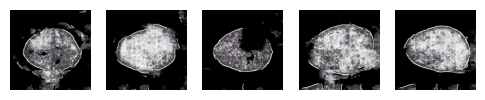

i=1850, loss: 0.175783  3.754156


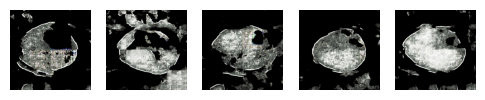

i=1900, loss: 0.082224  4.561059


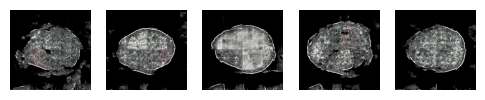

i=1950, loss: 0.113233  3.609554


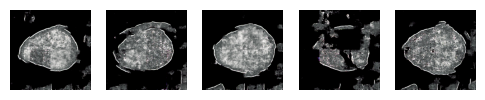

weights saved


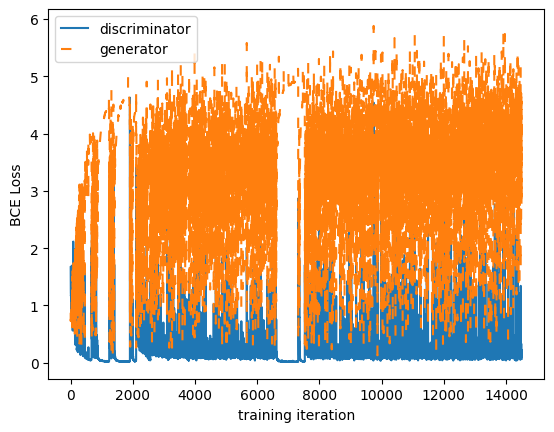

i=2000, loss: 0.066955  4.460779


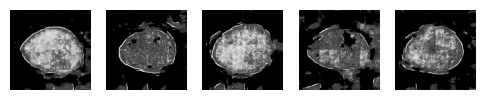

i=2050, loss: 0.091324  3.858370


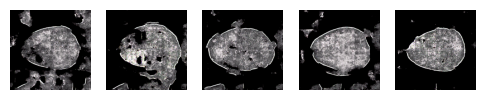

i=2100, loss: 0.204080  4.616779


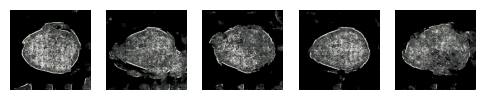

i=2150, loss: 0.105666  3.535571


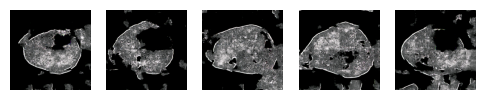

weights saved
i=2200, loss: 0.082632  4.591534


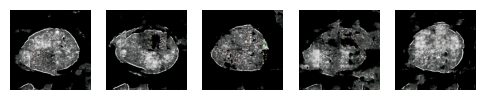

i=2250, loss: 0.175788  1.912986


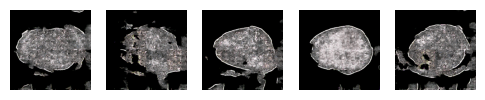

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00078/img00000588.png
i=2300, loss: 0.180369  4.506779


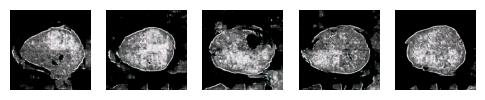

Traceback (most recent call last):
  File "/usr/lib/python3.10/multiprocessing/util.py", line 300, in _run_finalizers
    finalizer()
  File "/usr/lib/python3.10/multiprocessing/util.py", line 224, in __call__
    res = self._callback(*self._args, **self._kwargs)
  File "/usr/lib/python3.10/multiprocessing/util.py", line 133, in _remove_temp_dir
    rmtree(tempdir)
  File "/usr/lib/python3.10/shutil.py", line 731, in rmtree
    onerror(os.rmdir, path, sys.exc_info())
  File "/usr/lib/python3.10/shutil.py", line 729, in rmtree
    os.rmdir(path)
OSError: [Errno 39] Directory not empty: '/tmp/pymp-l1jrr9u2'


i=2350, loss: 0.089729  3.418242


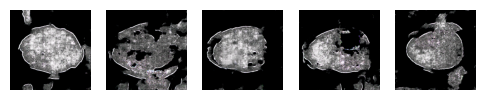

weights saved
i=2400, loss: 0.169869  3.718422


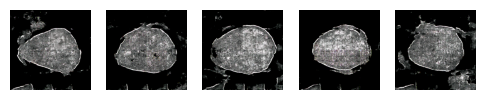

i=2450, loss: 0.446274  2.274187


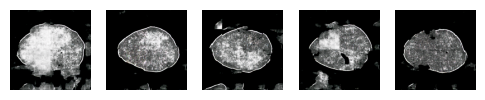

bad file /content/drive/MyDrive/Marquette Grad School/Deep_Generative_CT_Challenge/challenge_data/00071/img00000725.png


In [ ]:
loss_fn = torch.nn.BCELoss() 
d_losses, g_losses, train_images = train(train_dataloader,generator,discriminator,loss_fn,device)

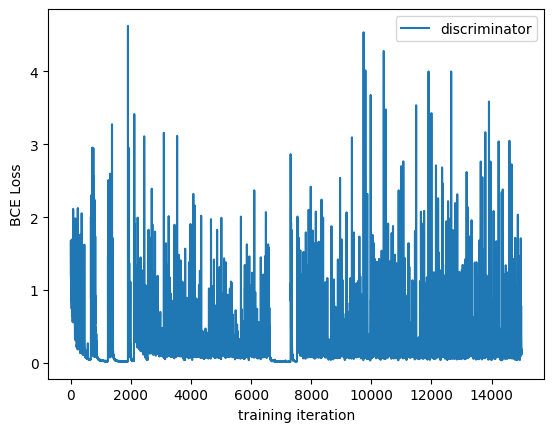

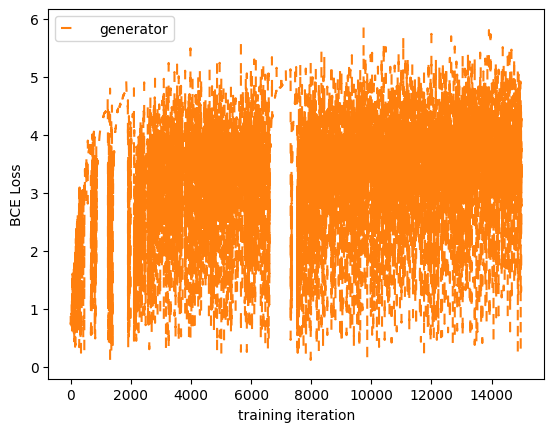

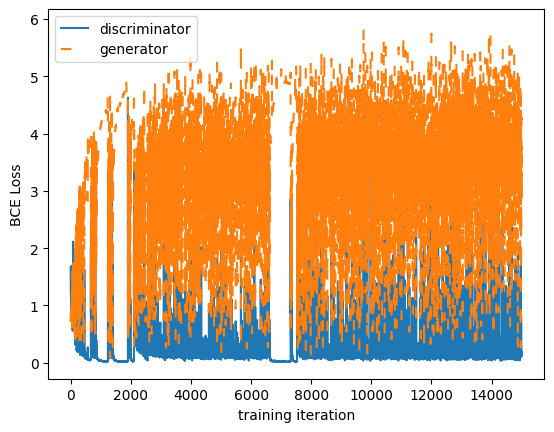

In [ ]:
plot_losses(d_losses, g_losses, 'all')

OLD: running long training again with slightly wider discriminator parameters

Generate and display a full batch of samples

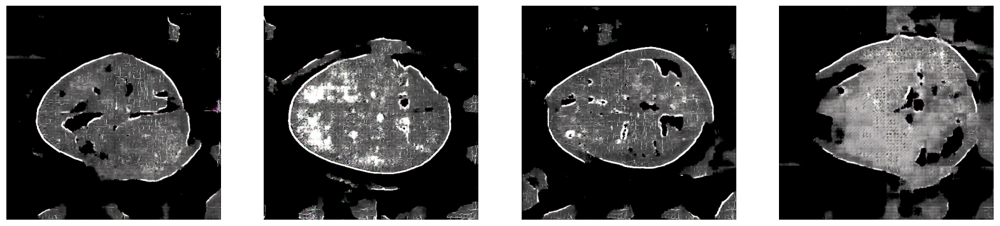

In [ ]:
noise = torch.randn(100 * batch_size,dtype=torch.float32)
#reshape into a batch of 8 grayscale images
noise=noise.reshape((batch_size, 100,1, 1))
images=generator(noise.to(device))
figure = plt.figure(figsize=(20, 20))
cols, rows = 4, 1
for i in range(batch_size-1):  
  figure.add_subplot(rows,cols, i+1)
  plt.axis("off")
  img=images[i].detach().permute(1,2,0).cpu().numpy()
  #normalize=transforms.Normalize(0,1)
  #imge=normalize(img)
  plt.imshow(img, cmap="gray")
plt.show()